In [13]:
import torch
import os
import matplotlib.pyplot as plt
import cv2
from PIL import Image
from tqdm import tqdm 
import numpy as np
import pandas as pd 
from glob import glob
import subprocess
import gc 
import shutil
import random

# ImageNet

In [2]:
checkpoint_prefix = "runwayml_imagenet_"
checkpoint_nums = ["500", "1000", "1500", "2000", "2500"]

In [3]:
checkpoint_name = "class0_tench"

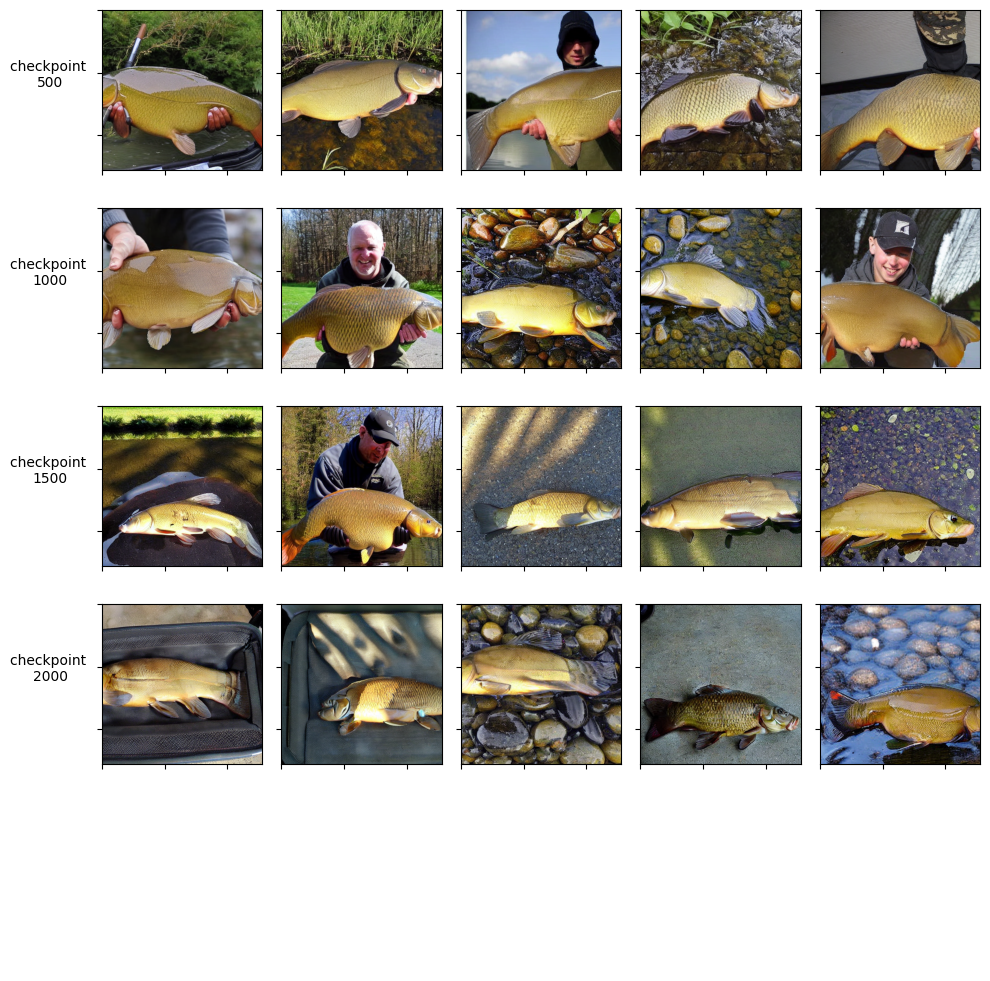

In [12]:
# row: checkpoints 
# col: 5 sample images 

num_images = 5
chosen_sample_imgs = {}

fig, ax = plt.subplots(5, num_images, figsize=(10,10))
for i, checkpoint_num in enumerate(checkpoint_nums): 
    dir = f"imagenet_runwayml_dreambooth_imgs/{checkpoint_prefix}{checkpoint_name}/checkpoint-{checkpoint_num}" 
    if not os.path.exists(dir): 
        for j in range(num_images): 
            ax[i, j].axis('off')
        continue
    img_paths = glob(dir + "/*.png")
    sample_img_paths = random.sample(img_paths, num_images)
    chosen_sample_imgs[checkpoint_num] = sample_img_paths

    for j, img_path in enumerate(sample_img_paths): 
        img = Image.open(img_path)
        ax[i, j].imshow(img)
        # ax[i, j].axis('off')
        ax[i, j].set_xticklabels([])
        ax[i, j].set_yticklabels([])
    ax[i, 0].set_ylabel("checkpoint \n{}".format(checkpoint_num), rotation=0, labelpad=30)
fig.tight_layout()
plt.show()

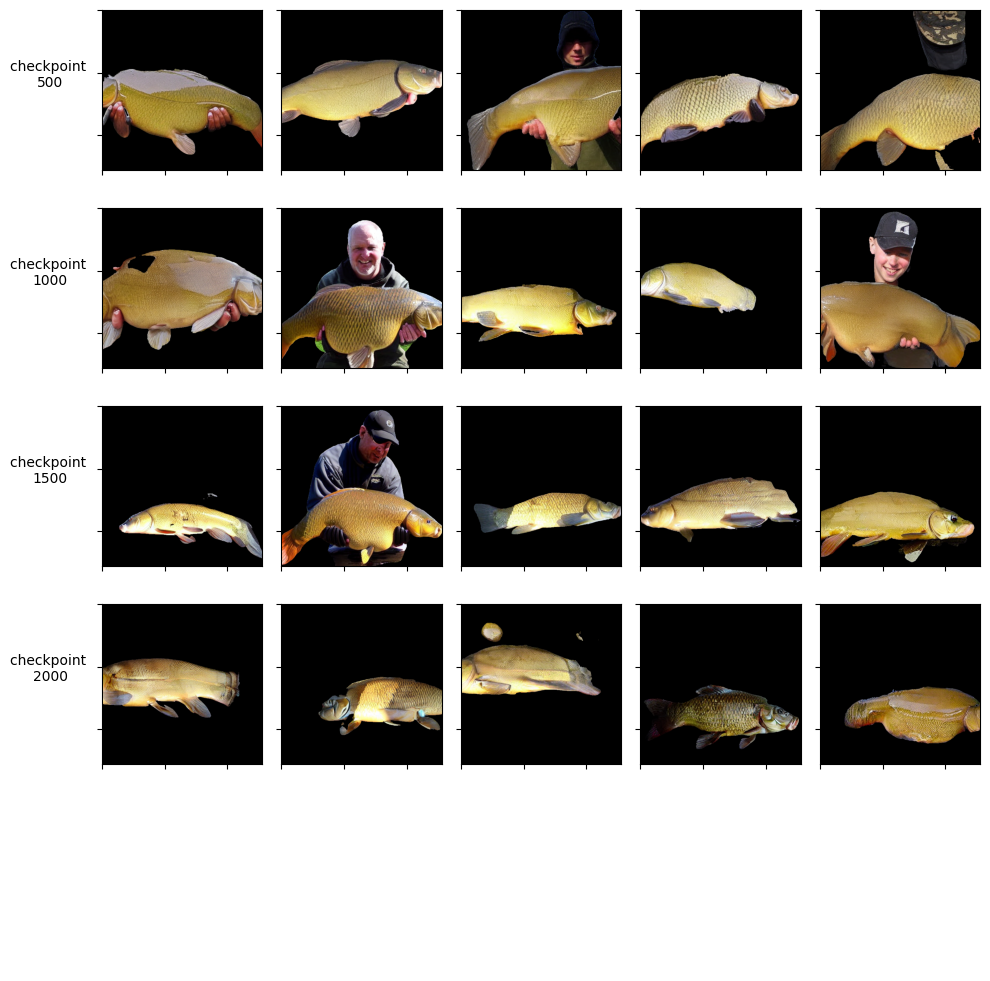

In [13]:
# Get the corresponding masked images 

num_images = 5
fig, ax = plt.subplots(5, num_images, figsize=(10,10))
for i, checkpoint_num in enumerate(checkpoint_nums): 
    if checkpoint_num not in chosen_sample_imgs: 
        for j in range(num_images): 
            ax[i, j].axis('off')
        continue
    img_numbers = [x.split(".png")[0].rsplit("image", maxsplit=1)[-1] for x in chosen_sample_imgs[checkpoint_num]]
    dir = f"imagenet_runwayml_dreambooth_imgs/{checkpoint_prefix}{checkpoint_name}/checkpoint-{checkpoint_num}-preprocessed"

    sample_img_paths_mask = [dir + f"/images{x}.png" for x in img_numbers]
        
    for j, img_path in enumerate(sample_img_paths_mask): 
        img = Image.open(img_path)
        ax[i, j].imshow(img)
        ax[i, j].set_xticklabels([])
        ax[i, j].set_yticklabels([])
    ax[i, 0].set_ylabel("checkpoint \n{}".format(checkpoint_num), rotation=0, labelpad=30)
fig.tight_layout()
plt.show()

# MIMIC-CXR

In [14]:
checkpoint_nums = ["500", "1000", "1500", "2000", "2500"]

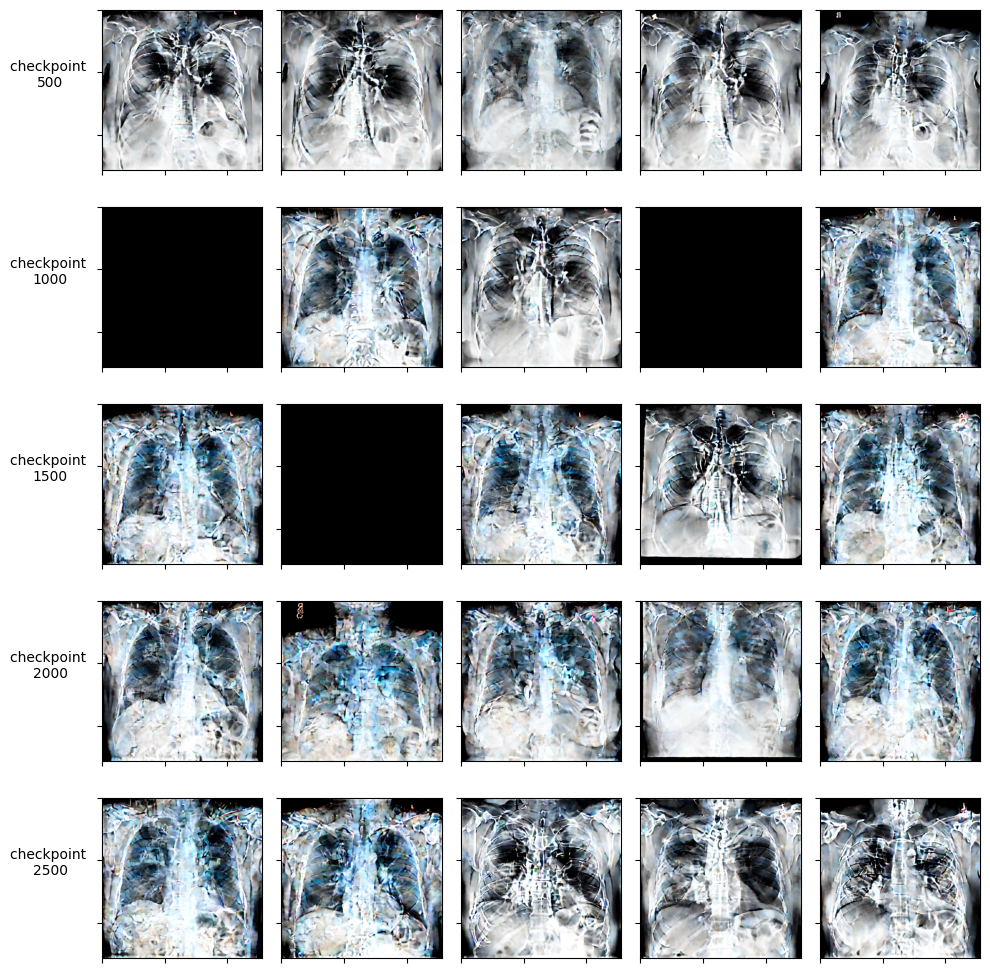

In [18]:
num_images = 5
chosen_sample_imgs = {}

fig, ax = plt.subplots(5, num_images, figsize=(10,10))
for i, checkpoint_num in enumerate(checkpoint_nums): 
    dir = f"roentgen_mimic-cxr_dreambooth_imgs/portable-left_portable/checkpoint-{checkpoint_num}" 
    if not os.path.exists(dir): 
        for j in range(num_images): 
            ax[i, j].axis('off')
        continue
    img_paths = glob(dir + "/*.png")
    sample_img_paths = random.sample(img_paths, num_images)
    chosen_sample_imgs[checkpoint_num] = sample_img_paths

    for j, img_path in enumerate(sample_img_paths): 
        img = Image.open(img_path)
        ax[i, j].imshow(img)
        # ax[i, j].axis('off')
        ax[i, j].set_xticklabels([])
        ax[i, j].set_yticklabels([])
    ax[i, 0].set_ylabel("checkpoint \n{}".format(checkpoint_num), rotation=0, labelpad=30)
fig.tight_layout()
plt.show()

# Waterbirds: live generation

In [14]:
from diffusers import StableDiffusionPipeline
from diffusers import DiffusionPipeline, UNet2DConditionModel

In [15]:
fig_dir = "/mnt/scratch-lids/scratch/qixuanj/waterbirds_finetune_sd_base/figs"
if not os.path.exists(fig_dir): 
    os.makedirs(fig_dir)

In [17]:
# Base model 
model_id = "runwayml/stable-diffusion-v1-5"
# checkpoints = np.arange(200, 2001, 200)
checkpoints = np.arange(200, 1001, 200)

for checkpoint in checkpoints: 
    # file_prefix = f"/mnt/scratch-lids/scratch/qixuanj/waterbirds_finetune_sd_base/checkpoint-{checkpoint}"
    file_prefix = f"/mnt/scratch-lids/scratch/qixuanj/waterbirds_finetune_sd_transfer_816/checkpoint-{checkpoint}"
    unet = UNet2DConditionModel.from_pretrained(f"{file_prefix}/unet")
    
    pipe = DiffusionPipeline.from_pretrained(model_id, unet=unet, dtype=torch.bfloat16)
    pipe.to("cuda")
    
    num_images = 5
    prompts = [
        "a photo of landbird with background of <wb-source-domain>", 
        "a photo of waterbird with background of <wb-source-domain>",
        "a photo of landbird with background of <wb-target-domain>", 
        "a photo of waterbird with background of <wb-target-domain>",
        "a photo of landbird with background of blue ocean or lake",
        "a photo of waterbird with background of green bamboo forest",
        "a photo of waterbird with background of blue ocean or lake",
        "a photo of landbird with background of green bamboo forest",
    ]
    
    fig, ax = plt.subplots(len(prompts), num_images, figsize=(10,10))
    
    for i, p in enumerate(prompts): 
        images = pipe(prompt=p, 
                      strength=0.9, guidance_scale=7.5, num_inference_steps=50, 
                      num_images_per_prompt=num_images).images
        for j, img in enumerate(images): 
            ax[i, j].imshow(img)
            ax[i, j].set_xticklabels([])
            ax[i, j].set_yticklabels([])
        # ax[i, 0].set_ylabel("dataset \n{}".format(i), rotation=0, labelpad=50)
    fig.tight_layout()
    plt.savefig(fig_dir + f"/checkpoint{checkpoint}.png", dpi=300)
    plt.show()

KeyboardInterrupt: 

# CXR: live generation

In [2]:
from diffusers import StableDiffusionPipeline
from diffusers import DiffusionPipeline, UNet2DConditionModel

/data/healthy-ml/scratch/qixuanj/anaconda3/envs/control/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
# model_id = "roentgen"
# file_prefix = "/data/scratch/qixuanj/cxr_finetune_roentgen/checkpoint-3000"

model_id = "runwayml/stable-diffusion-v1-5"
file_prefix = "/data/scratch/qixuanj/cxr_transfer_sd_mimic_chexpert_1000_balanced/checkpoint-200"
unet = UNet2DConditionModel.from_pretrained(f"{file_prefix}/unet")

pipe = DiffusionPipeline.from_pretrained(model_id, unet=unet, dtype=torch.float16)
pipe.to("cuda")

OSError: We couldn't connect to 'https://huggingface.co' to load this model, couldn't find it in the cached files and it looks like /data/scratch/qixuanj/cxr_transfer_sd_mimic_chexpert_1000_balanced/checkpoint-200/unet is not the path to a directory containing a config.json file.
Checkout your internet connection or see how to run the library in offline mode at 'https://huggingface.co/docs/diffusers/installation#offline-mode'.

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:17<00:00,  2.85it/s]


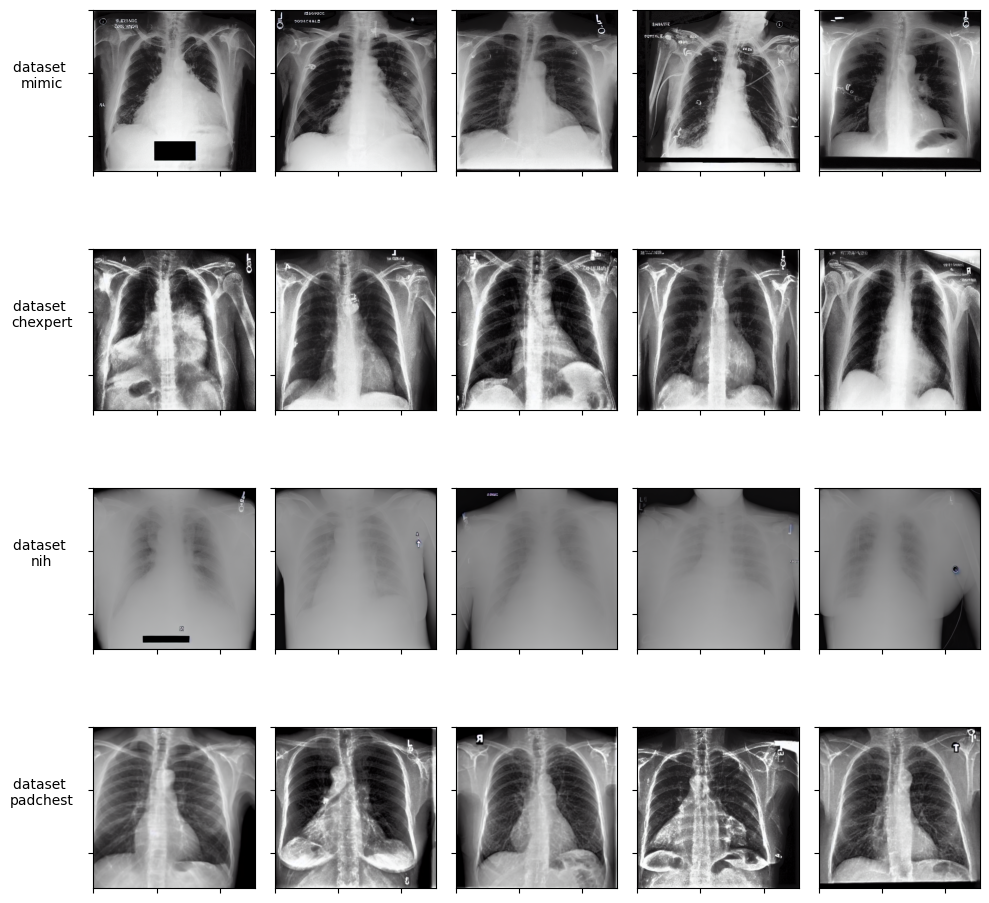

In [21]:
num_images = 5
prompts = [
    "a radiograph from dataset mimic with conditions Cardiomegaly, Pneumonia", 
    "a radiograph from dataset chexpert with conditions Cardiomegaly, Pneumonia", 
    "a radiograph from dataset nih with conditions Cardiomegaly, Pneumonia",
    "a radiograph from dataset padchest with conditions Cardiomegaly, Pneumonia"
]

fig, ax = plt.subplots(len(prompts), num_images, figsize=(10,10))

for i, p in enumerate(prompts): 
    images = pipe(prompt=p, 
                  strength=0.9, guidance_scale=7.5, num_inference_steps=50, 
                  num_images_per_prompt=num_images).images
    for j, img in enumerate(images): 
        ax[i, j].imshow(img)
        ax[i, j].set_xticklabels([])
        ax[i, j].set_yticklabels([])
    ax[i, 0].set_ylabel("dataset \n{}".format(datasets[i]), rotation=0, labelpad=30)
fig.tight_layout()
plt.show()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:17<00:00,  2.84it/s]
Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.
100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:17<00:00,  2.84it/s]
Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.
100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:17<00:00,  2.83it/s]


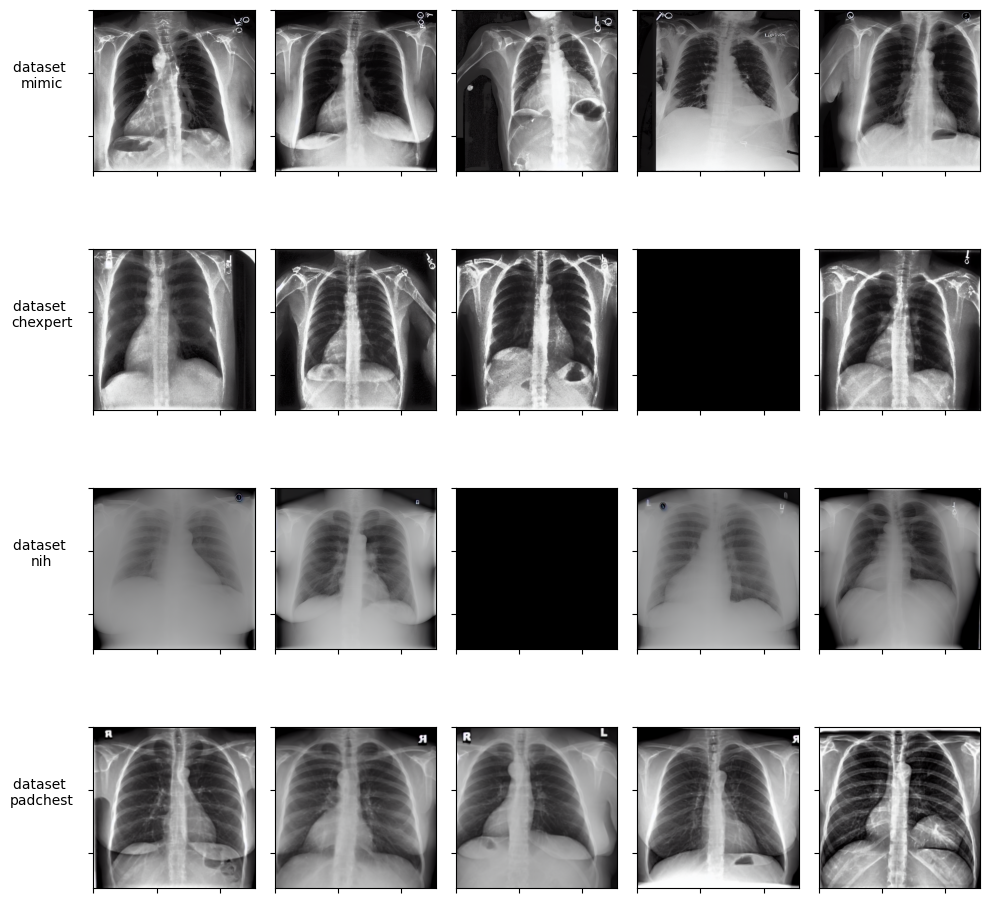

In [22]:
num_images = 5
datasets = ["mimic", "chexpert", "nih", "padchest"]
prompts = [
    "a radiograph from dataset mimic with conditions No Finding", 
    "a radiograph from dataset chexpert with conditions No Finding", 
    "a radiograph from dataset nih with conditions No Finding",
    "a radiograph from dataset padchest with conditions No Finding"
]

fig, ax = plt.subplots(len(prompts), num_images, figsize=(10,10))

for i, p in enumerate(prompts): 
    images = pipe(prompt=p, 
                  strength=0.9, guidance_scale=7.5, num_inference_steps=50, 
                  num_images_per_prompt=num_images).images
    for j, img in enumerate(images): 
        ax[i, j].imshow(img)
        ax[i, j].set_xticklabels([])
        ax[i, j].set_yticklabels([])
    ax[i, 0].set_ylabel("dataset \n{}".format(datasets[i]), rotation=0, labelpad=30)
fig.tight_layout()
plt.show()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:17<00:00,  2.82it/s]
Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.
100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:17<00:00,  2.81it/s]


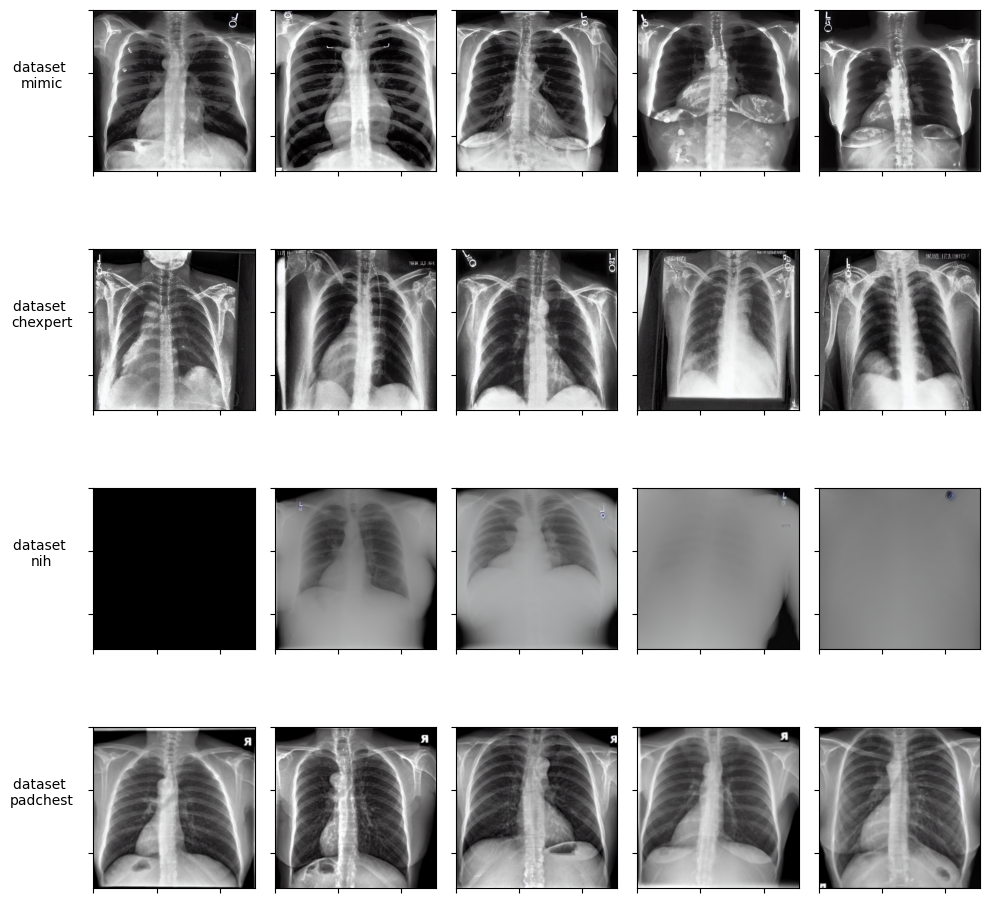

In [23]:
num_images = 5
datasets = ["mimic", "chexpert", "nih", "padchest"]
prompts = [
    "a radiograph from dataset mimic with conditions ", 
    "a radiograph from dataset chexpert with conditions ", 
    "a radiograph from dataset nih with conditions ",
    "a radiograph from dataset padchest with conditions "
]

fig, ax = plt.subplots(len(prompts), num_images, figsize=(10,10))

for i, p in enumerate(prompts): 
    images = pipe(prompt=p, 
                  strength=0.9, guidance_scale=7.5, num_inference_steps=50, 
                  num_images_per_prompt=num_images).images
    for j, img in enumerate(images): 
        ax[i, j].imshow(img)
        ax[i, j].set_xticklabels([])
        ax[i, j].set_yticklabels([])
    ax[i, 0].set_ylabel("dataset \n{}".format(datasets[i]), rotation=0, labelpad=30)
fig.tight_layout()
plt.show()

In [18]:
fig_dir = "/mnt/scratch-lids/scratch/qixuanj/cxr_finetune_sd_mimic_base/figs"
if not os.path.exists(fig_dir): 
    os.makedirs(fig_dir)

Keyword arguments {'dtype': torch.bfloat16} are not expected by StableDiffusionPipeline and will be ignored.
100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:36<00:00,  1.36it/s]


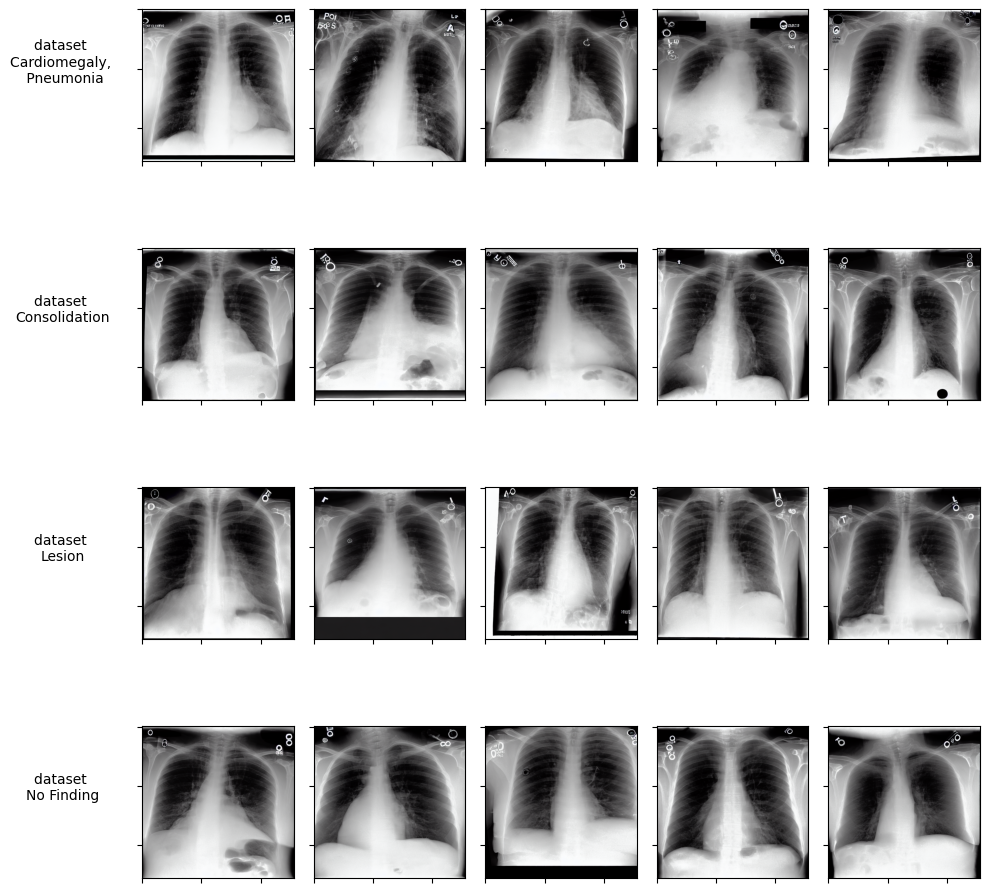

Keyword arguments {'dtype': torch.bfloat16} are not expected by StableDiffusionPipeline and will be ignored.
100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:17<00:00,  2.88it/s]


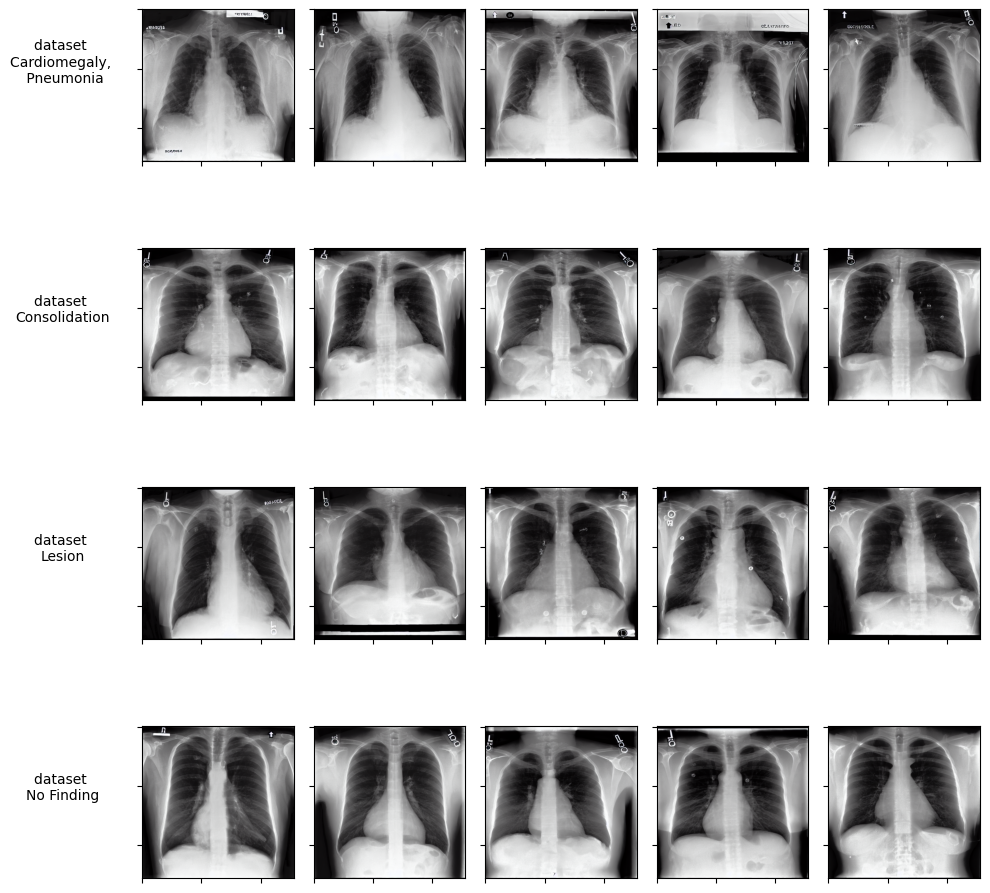

Keyword arguments {'dtype': torch.bfloat16} are not expected by StableDiffusionPipeline and will be ignored.
100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:17<00:00,  2.89it/s]


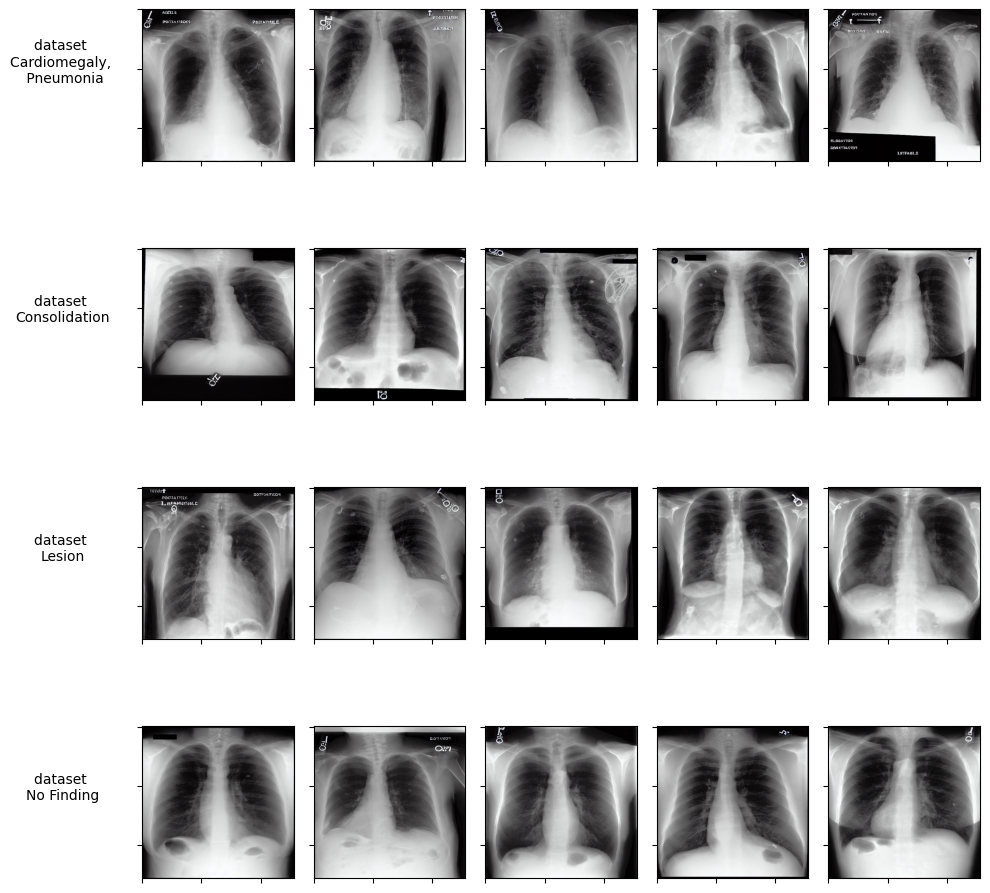

Keyword arguments {'dtype': torch.bfloat16} are not expected by StableDiffusionPipeline and will be ignored.
100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:37<00:00,  1.33it/s]


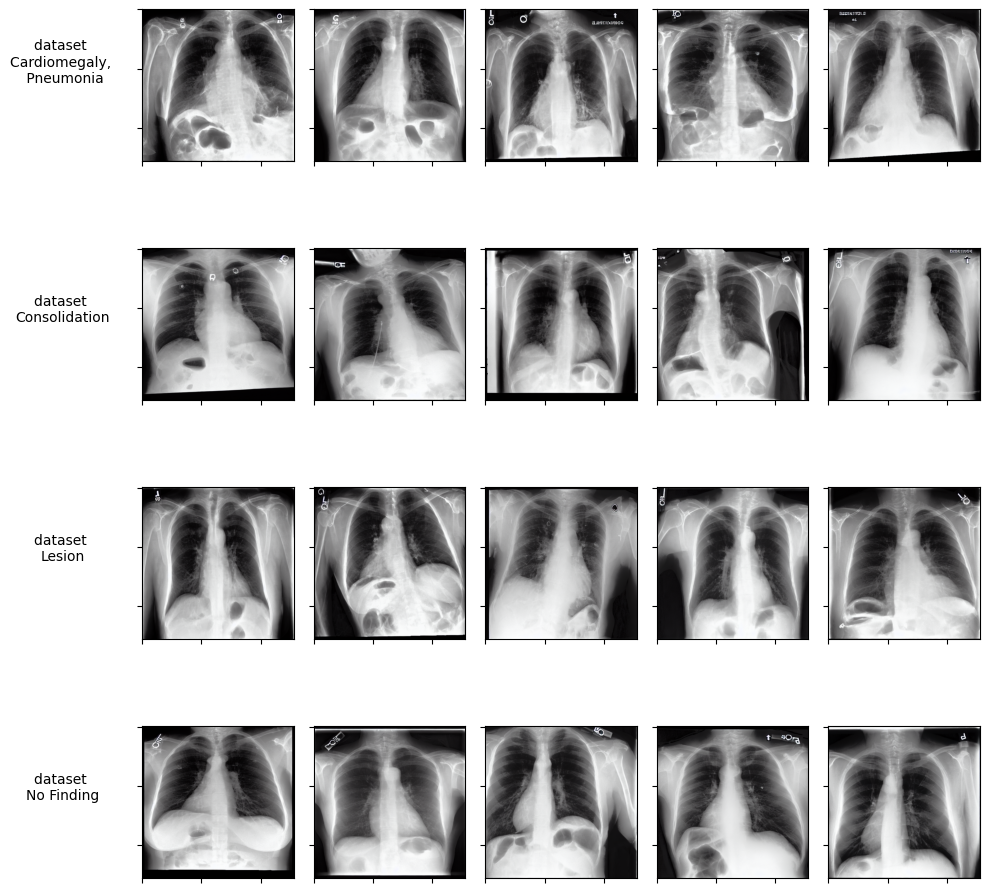

Keyword arguments {'dtype': torch.bfloat16} are not expected by StableDiffusionPipeline and will be ignored.
100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:37<00:00,  1.35it/s]


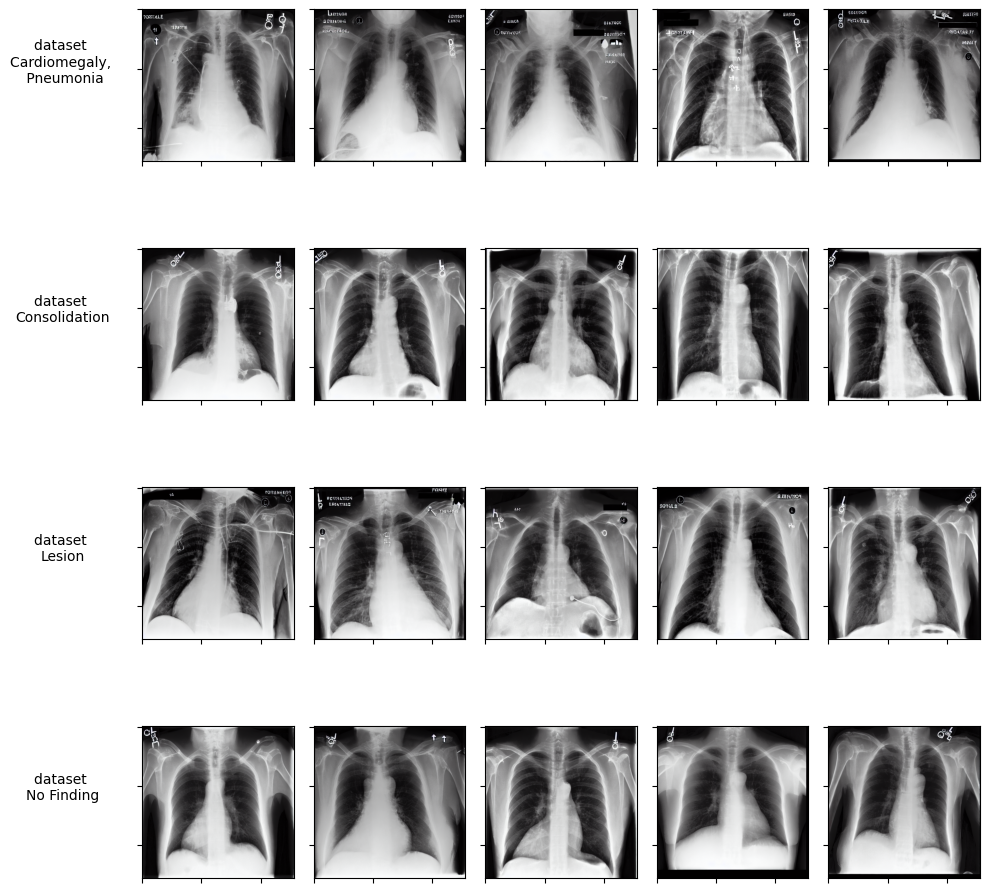

Keyword arguments {'dtype': torch.bfloat16} are not expected by StableDiffusionPipeline and will be ignored.
100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:37<00:00,  1.35it/s]
Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.
100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:36<00:00,  1.36it/s]


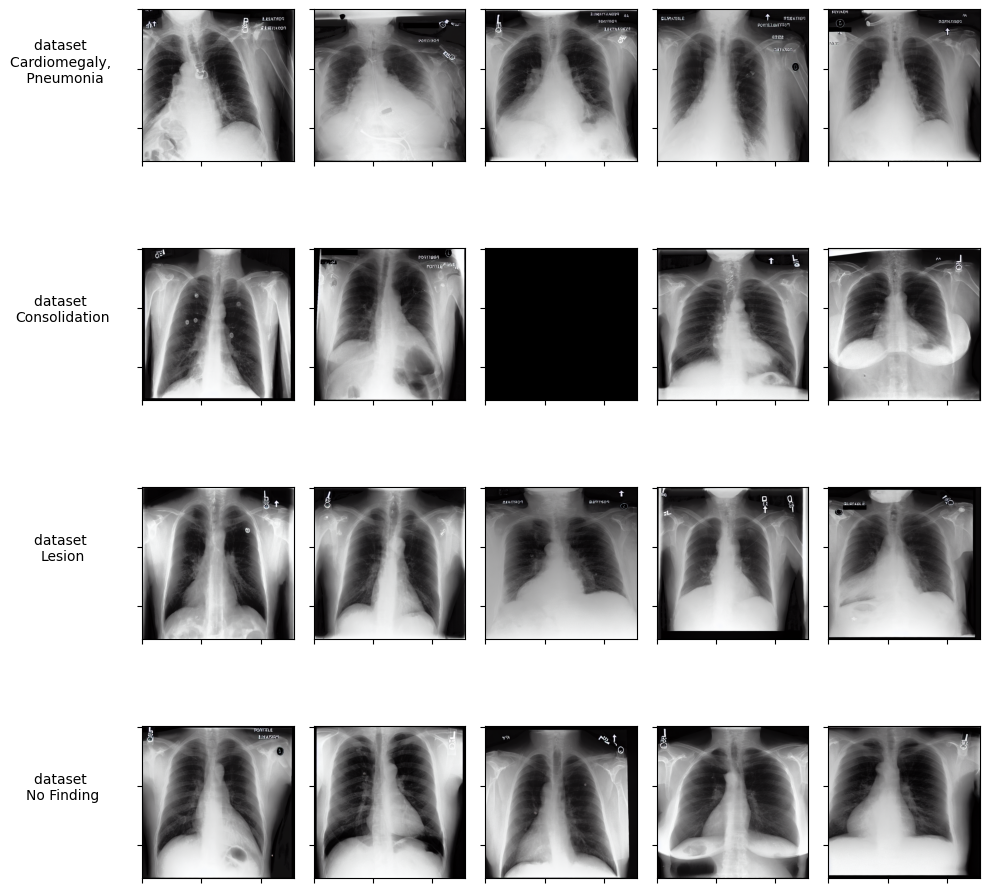

Keyword arguments {'dtype': torch.bfloat16} are not expected by StableDiffusionPipeline and will be ignored.
100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:38<00:00,  1.30it/s]


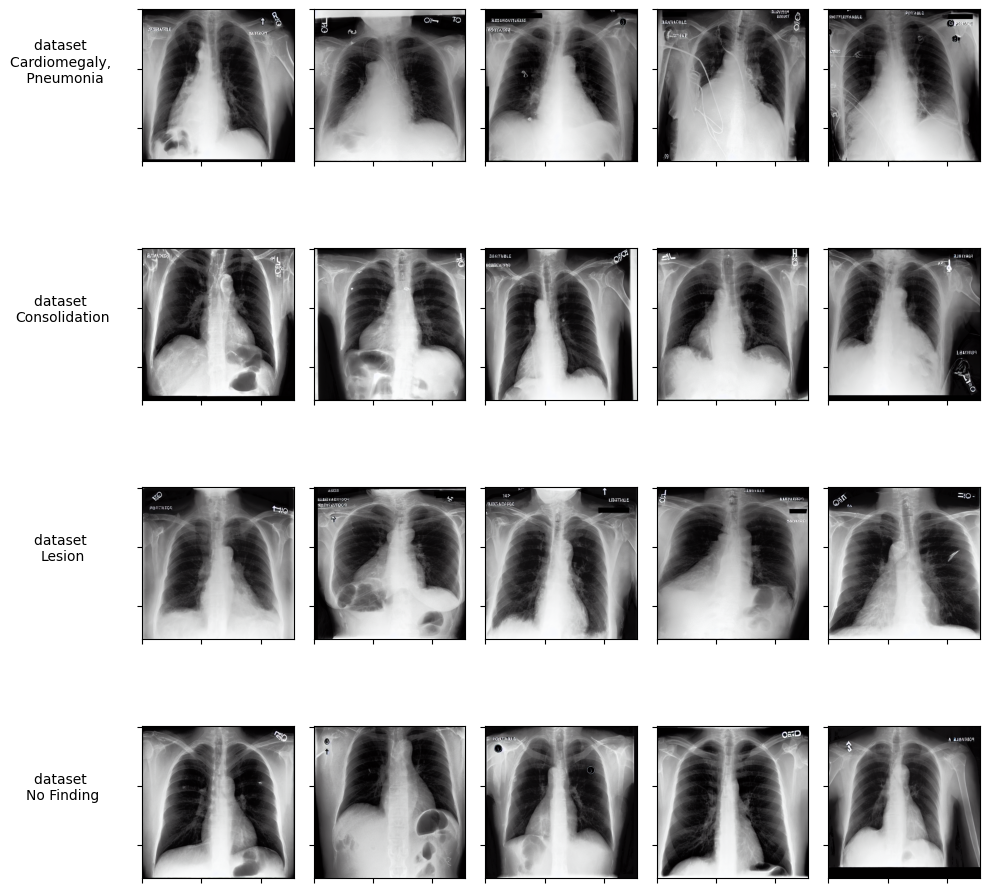

Keyword arguments {'dtype': torch.bfloat16} are not expected by StableDiffusionPipeline and will be ignored.
100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:36<00:00,  1.36it/s]


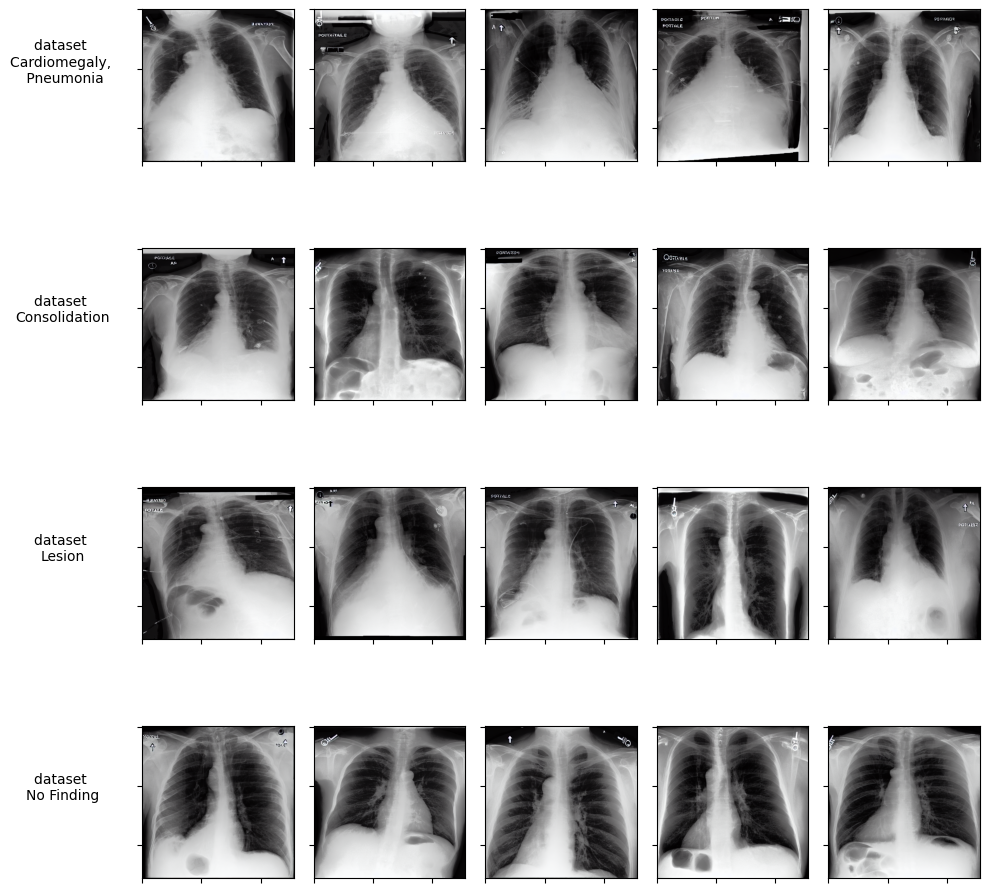

Keyword arguments {'dtype': torch.bfloat16} are not expected by StableDiffusionPipeline and will be ignored.
100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:38<00:00,  1.30it/s]


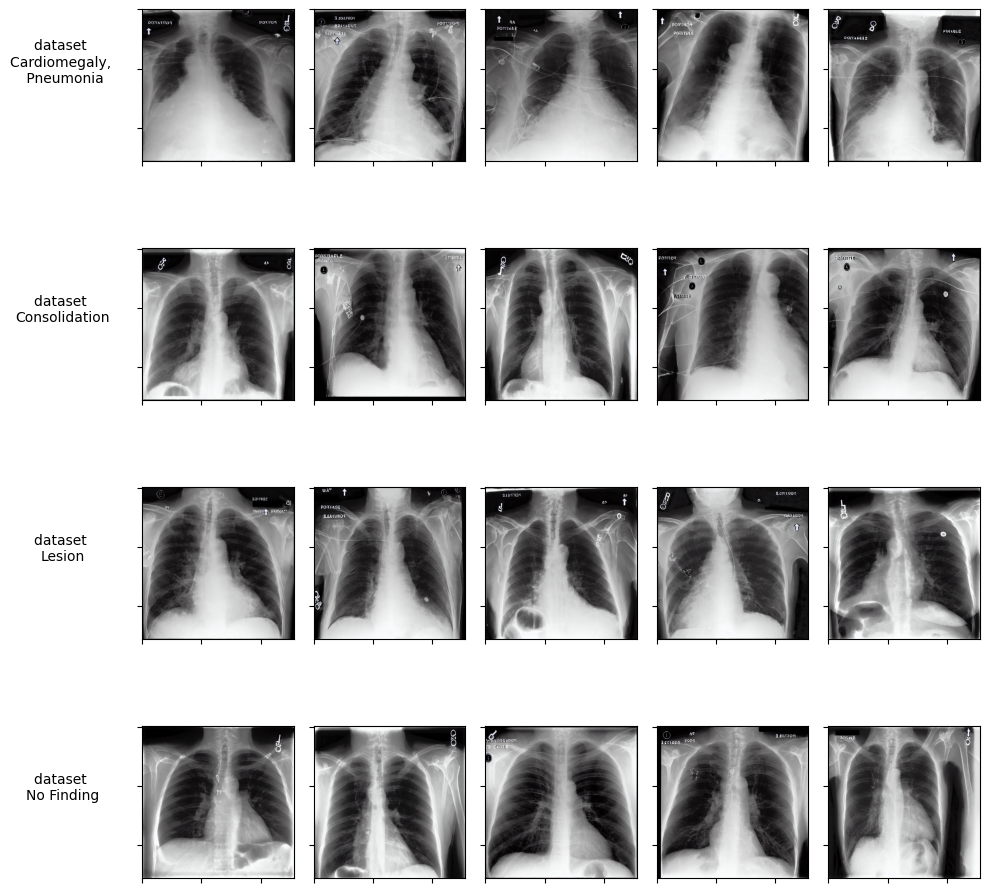

Keyword arguments {'dtype': torch.bfloat16} are not expected by StableDiffusionPipeline and will be ignored.
100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:17<00:00,  2.89it/s]


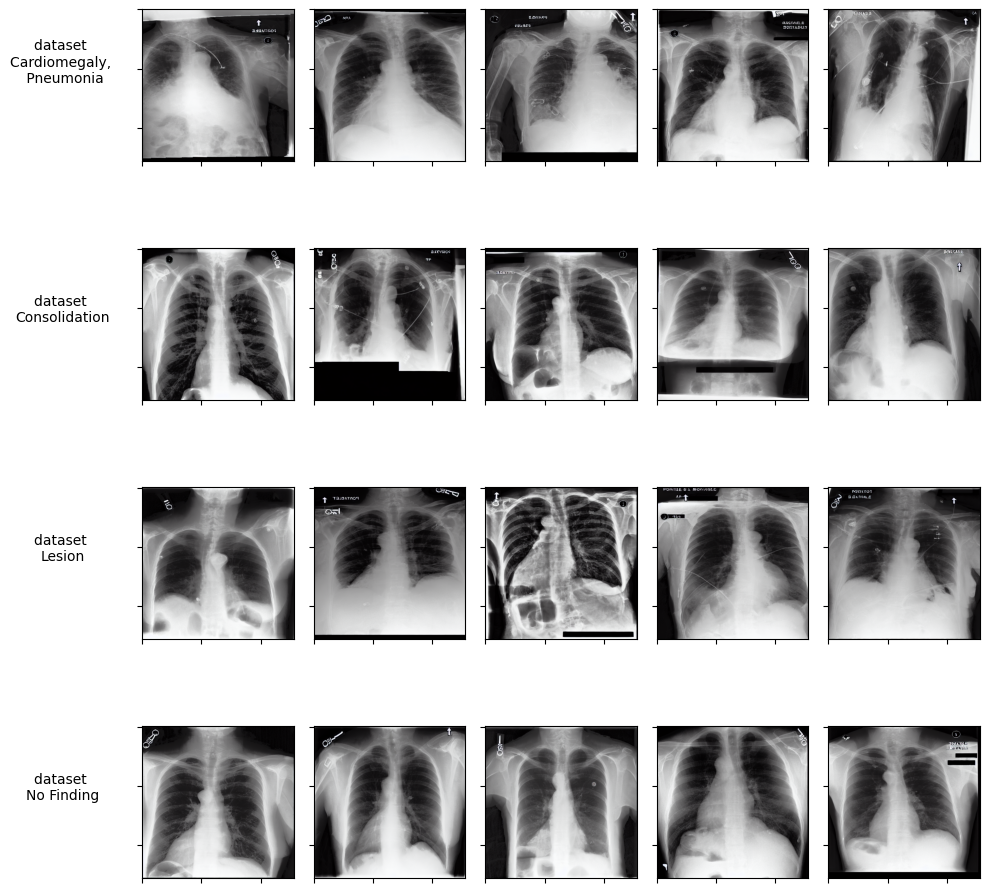

In [21]:
# Base model 
dataset = "mimic"
model_id = "runwayml/stable-diffusion-v1-5"
checkpoints = np.arange(500, 5001, 500)

for checkpoint in checkpoints: 
    file_prefix = f"/mnt/scratch-lids/scratch/qixuanj/cxr_finetune_sd_{dataset}_base/checkpoint-{checkpoint}"
    unet = UNet2DConditionModel.from_pretrained(f"{file_prefix}/unet")
    
    pipe = DiffusionPipeline.from_pretrained(model_id, unet=unet, dtype=torch.bfloat16)
    pipe.to("cuda")
    
    num_images = 5
    prompts = [
        "Cardiomegaly, Pneumonia", 
        "Consolidation", 
        "Lesion",
        "No Finding",
    ]
    
    fig, ax = plt.subplots(len(prompts), num_images, figsize=(10,10))
    
    for i, p in enumerate(prompts): 
        prompt = f"a radiograph from dataset {dataset} with conditions {p}"
        images = pipe(prompt=prompt, 
                      strength=0.9, guidance_scale=7.5, num_inference_steps=50, 
                      num_images_per_prompt=num_images).images
        for j, img in enumerate(images): 
            ax[i, j].imshow(img)
            ax[i, j].set_xticklabels([])
            ax[i, j].set_yticklabels([])
        if p == "Cardiomegaly, Pneumonia": 
            p = "Cardiomegaly, \n Pneumonia"
        ax[i, 0].set_ylabel("dataset \n{}".format(p), rotation=0, labelpad=50)
    fig.tight_layout()
    plt.savefig(fig_dir + f"/checkpoint{checkpoint}.png", dpi=300)
    plt.show()

Keyword arguments {'dtype': torch.bfloat16} are not expected by StableDiffusionPipeline and will be ignored.
100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:12<00:00,  3.90it/s]


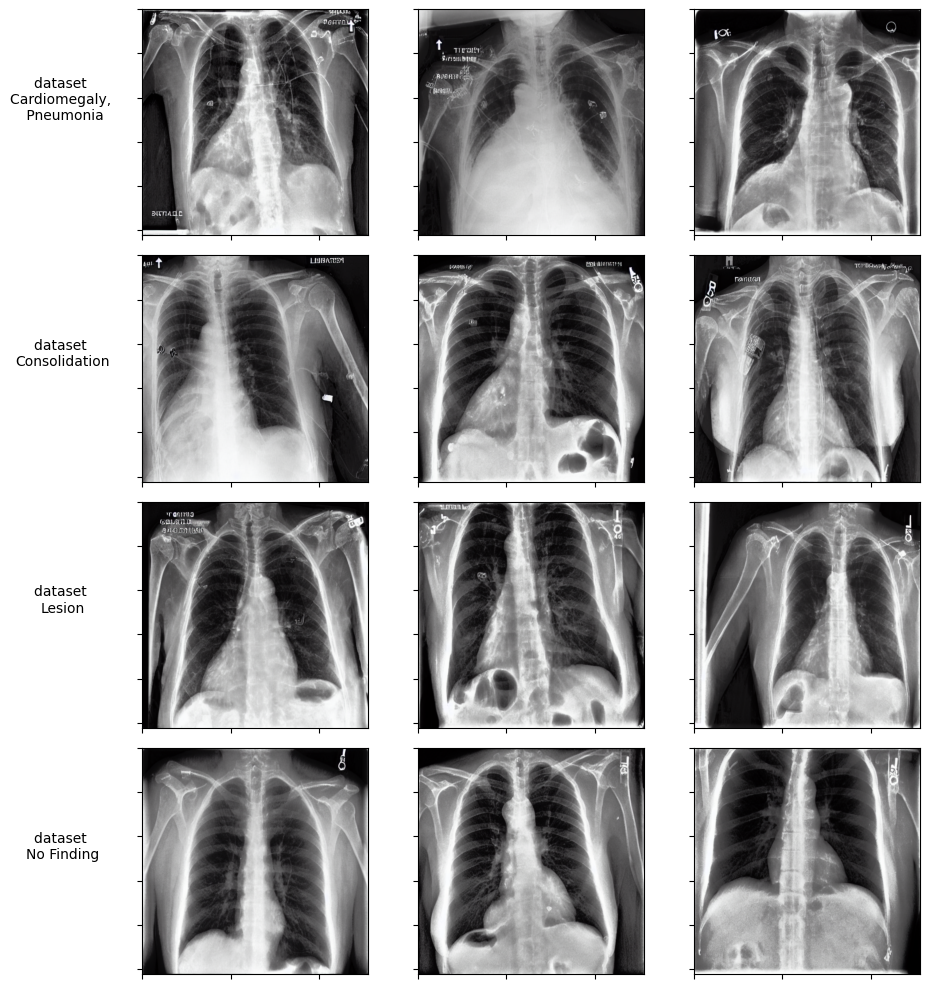

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:16<00:00,  3.05it/s]


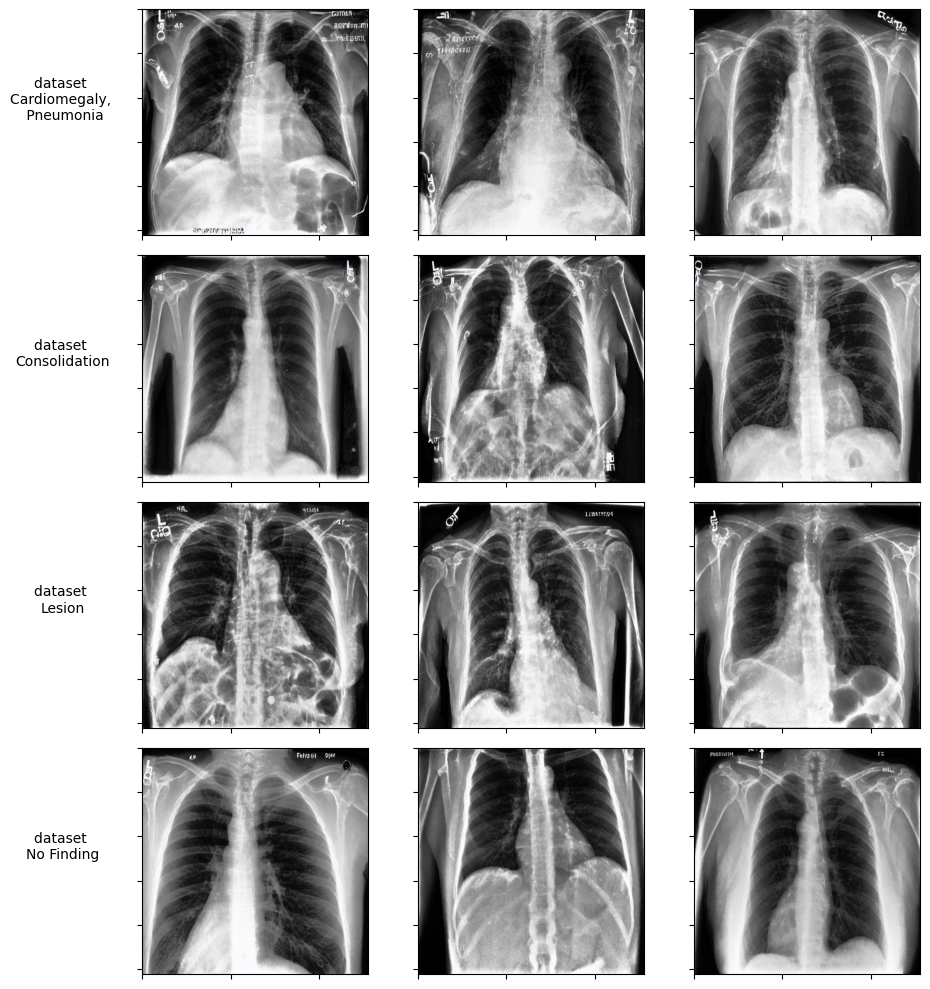

Keyword arguments {'dtype': torch.bfloat16} are not expected by StableDiffusionPipeline and will be ignored.
100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:12<00:00,  3.95it/s]


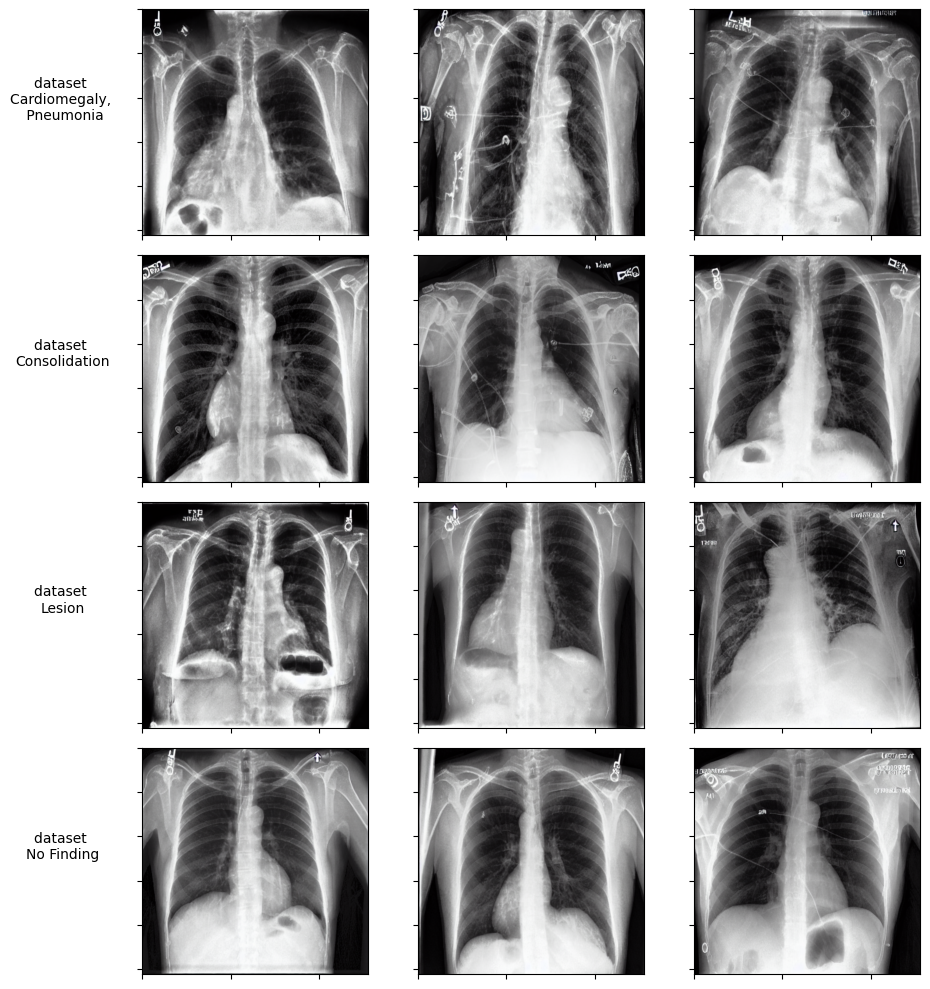

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:12<00:00,  3.92it/s]


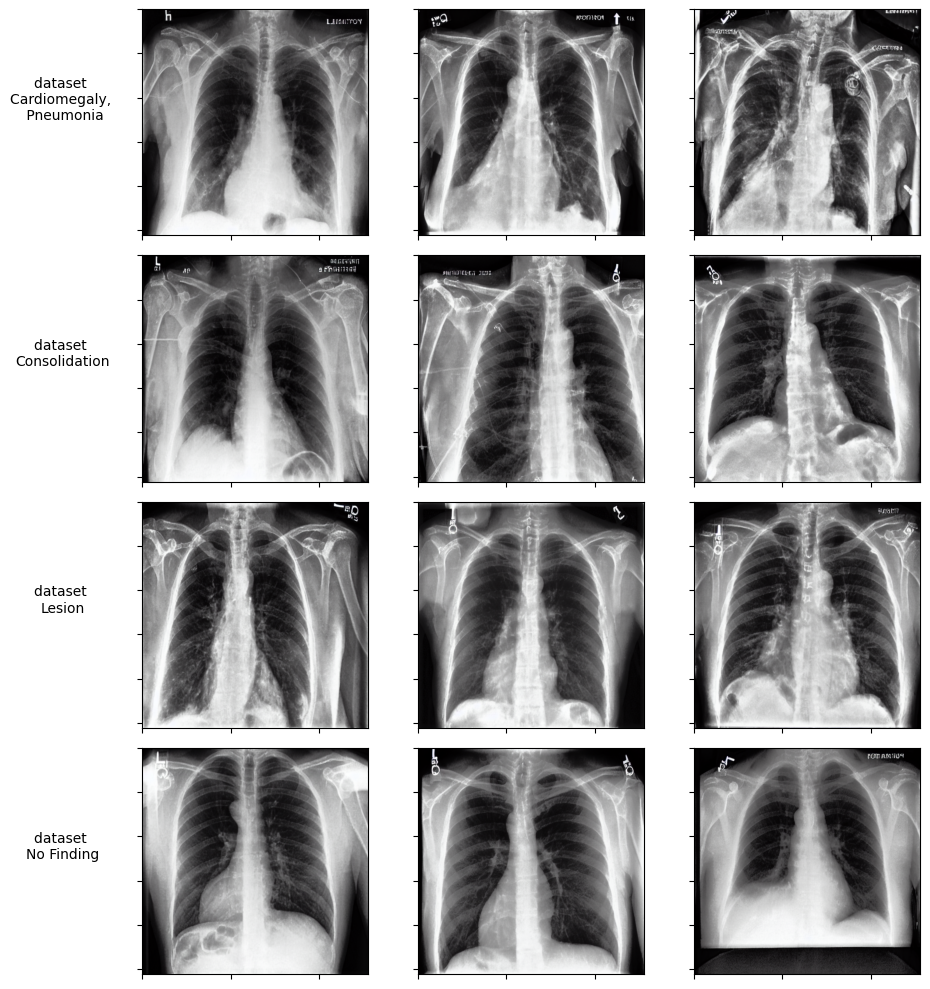

Keyword arguments {'dtype': torch.bfloat16} are not expected by StableDiffusionPipeline and will be ignored.
100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:16<00:00,  3.03it/s]


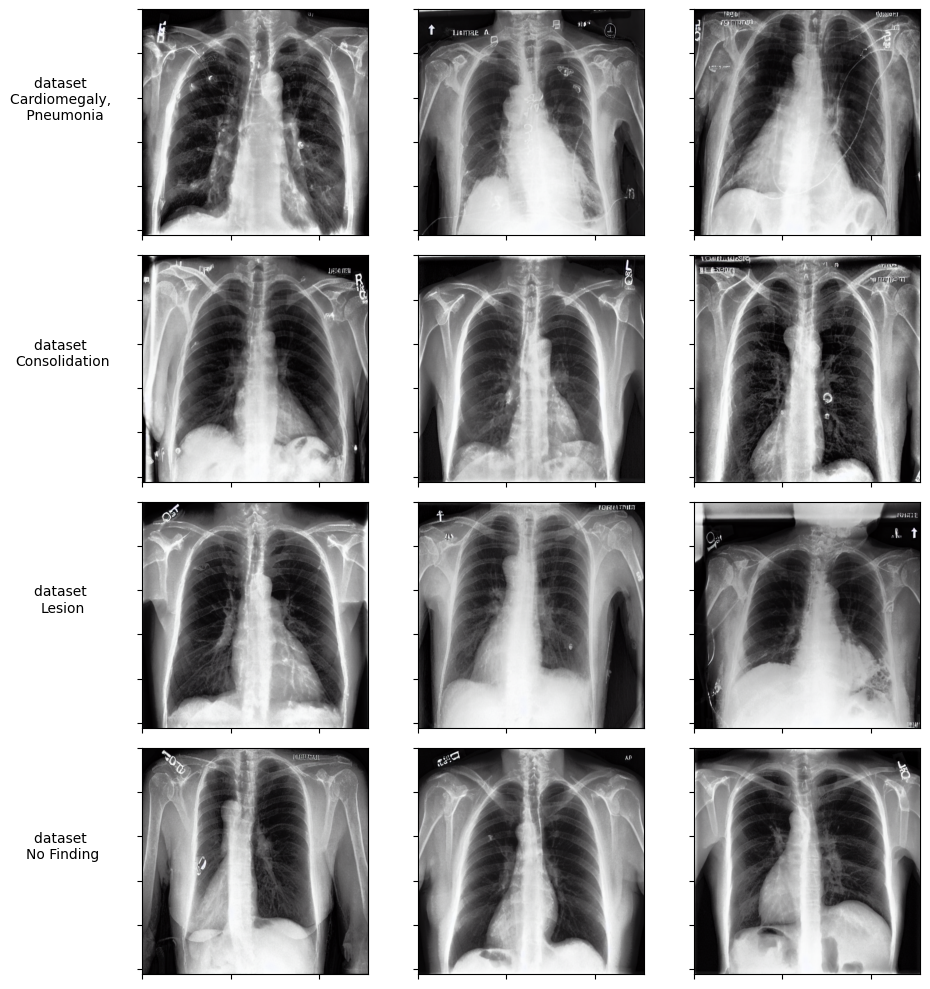

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:14<00:00,  3.40it/s]
Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.
100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:12<00:00,  3.90it/s]


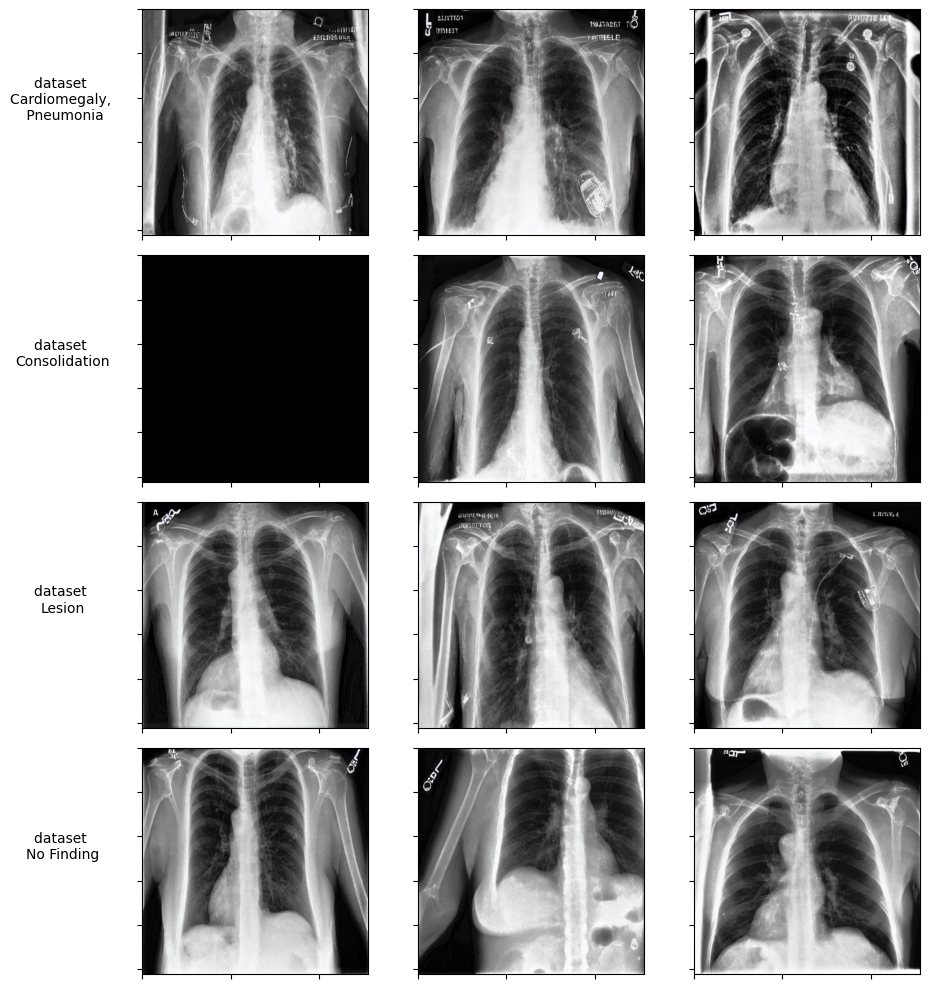

In [8]:
# Transfer model 
model_id = "runwayml/stable-diffusion-v1-5"
keyword = "cxr_transfer_sd_mimic_chexpert_1000_balanced"
# checkpoints = np.arange(200, 1001, 200)

checkpoints = [600, 800, 1000]
for checkpoint in checkpoints: 
    file_prefix = f"/mnt/scratch-lids/scratch/qixuanj/{keyword}/checkpoint-{checkpoint}"
    fig_dir = f"/mnt/scratch-lids/scratch/qixuanj/{keyword}/figs"
    if not os.path.exists(fig_dir): 
        os.makedirs(fig_dir)
    unet = UNet2DConditionModel.from_pretrained(f"{file_prefix}/unet")
    
    pipe = DiffusionPipeline.from_pretrained(model_id, unet=unet, dtype=torch.bfloat16)
    pipe.to("cuda")
    
    num_images = 3
    prompts = [
        "Cardiomegaly, Pneumonia", 
        "Consolidation", 
        "Lesion",
        "No Finding",
    ]
    
    fig, ax = plt.subplots(len(prompts), num_images, figsize=(10,10))
    for i, p in enumerate(prompts): 
        prompt = f"a radiograph from dataset mimic with conditions {p}"
        images = pipe(prompt=prompt, 
                      strength=0.9, guidance_scale=7.5, num_inference_steps=50, 
                      num_images_per_prompt=num_images).images
        for j, img in enumerate(images): 
            ax[i, j].imshow(img)
            ax[i, j].set_xticklabels([])
            ax[i, j].set_yticklabels([])
        if p == "Cardiomegaly, Pneumonia": 
            p = "Cardiomegaly, \n Pneumonia"
        ax[i, 0].set_ylabel("dataset \n{}".format(p), rotation=0, labelpad=50)
    fig.tight_layout()
    plt.savefig(fig_dir + f"/mimic_checkpoint{checkpoint}.png", dpi=300)
    plt.show()

    transfer_dataset = keyword.split("_")[-3]
    fig, ax = plt.subplots(len(prompts), num_images, figsize=(10,10))
    for i, p in enumerate(prompts): 
        prompt = f"a radiograph from dataset {transfer_dataset} with conditions {p}"
        images = pipe(prompt=prompt, 
                      strength=0.9, guidance_scale=7.5, num_inference_steps=50, 
                      num_images_per_prompt=num_images).images
        for j, img in enumerate(images): 
            ax[i, j].imshow(img)
            ax[i, j].set_xticklabels([])
            ax[i, j].set_yticklabels([])
        if p == "Cardiomegaly, Pneumonia": 
            p = "Cardiomegaly, \n Pneumonia"
        ax[i, 0].set_ylabel("dataset \n{}".format(p), rotation=0, labelpad=50)
    fig.tight_layout()
    plt.savefig(fig_dir + f"/{transfer_dataset}_checkpoint{checkpoint}.png", dpi=300)
    plt.show()

In [ ]:
missing = ["cxr_transfer_sd_mimic_chexpert_100_balanced", 
       "cxr_transfer_sd_mimic_chexpert_10_balanced",
          "cxr_transfer_sd_mimic_chexpert_500_match",
           "cxr_transfer_sd_mimic_chexpert_50_balanced",
           ]

Keyword arguments {'dtype': torch.bfloat16} are not expected by StableDiffusionPipeline and will be ignored.
100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:16<00:00,  3.03it/s]


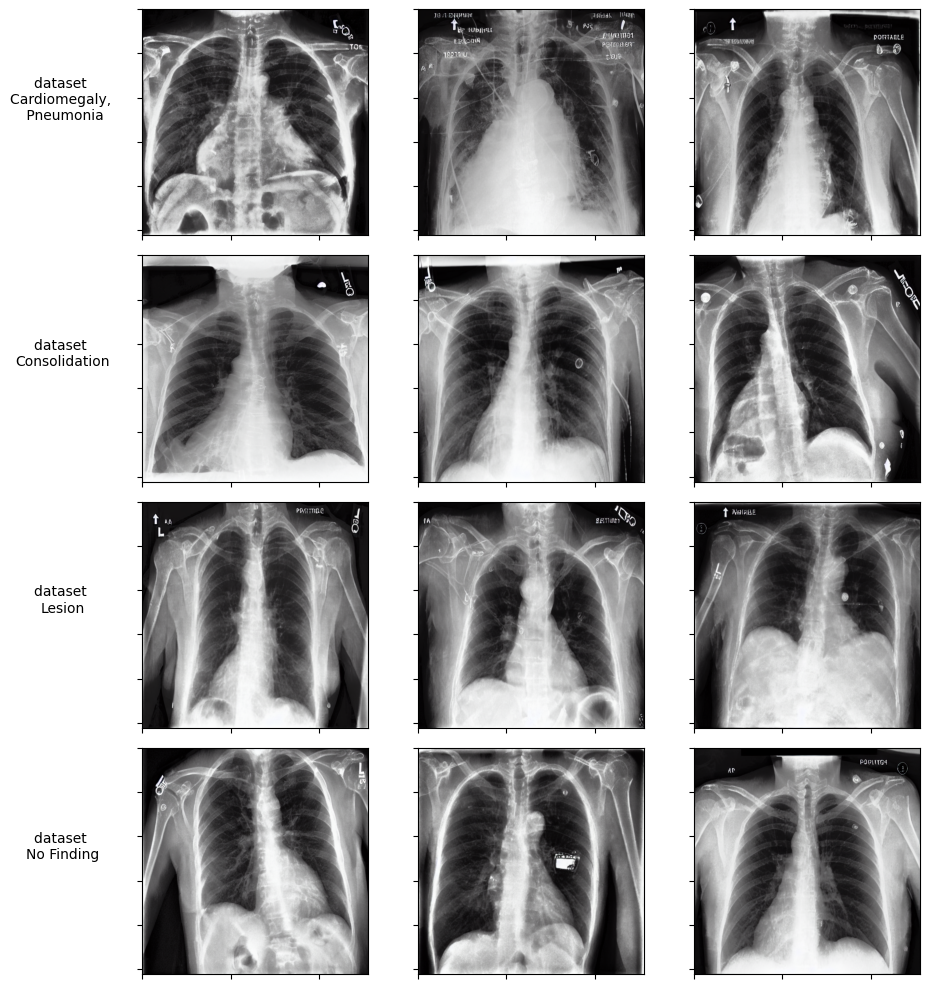

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:16<00:00,  3.03it/s]


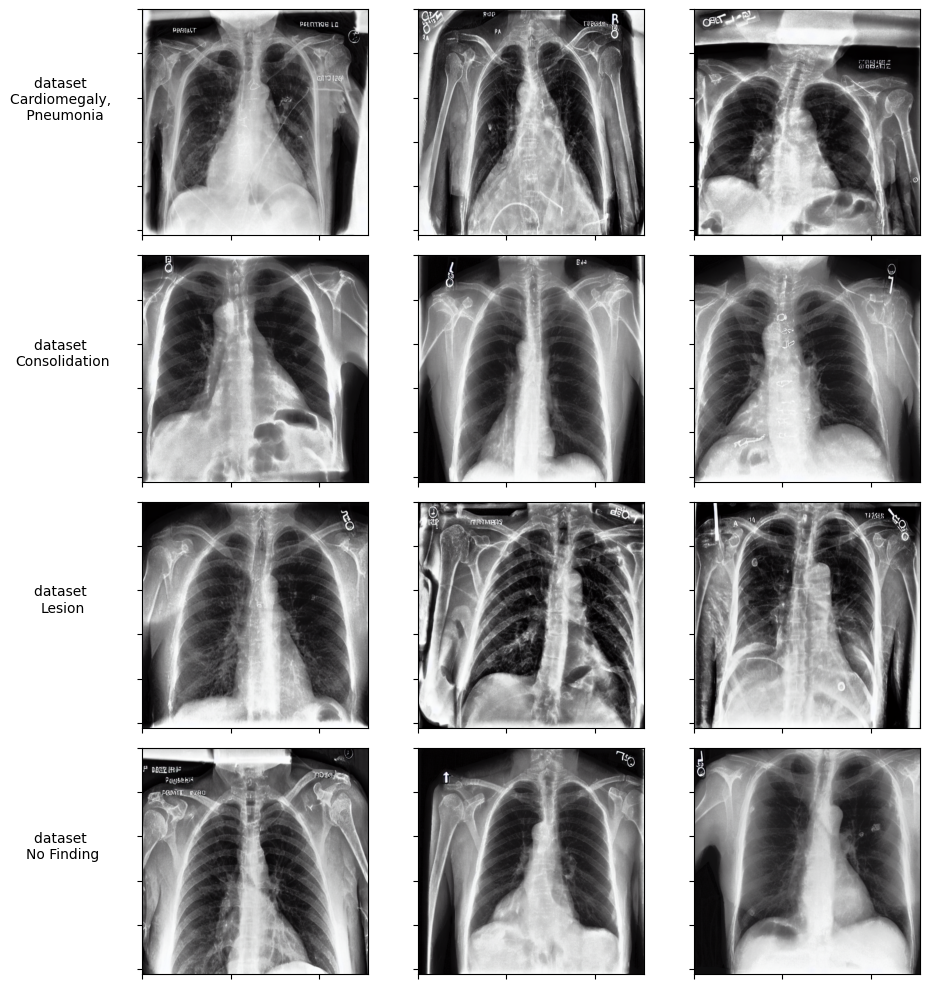

Keyword arguments {'dtype': torch.bfloat16} are not expected by StableDiffusionPipeline and will be ignored.
100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:16<00:00,  3.03it/s]


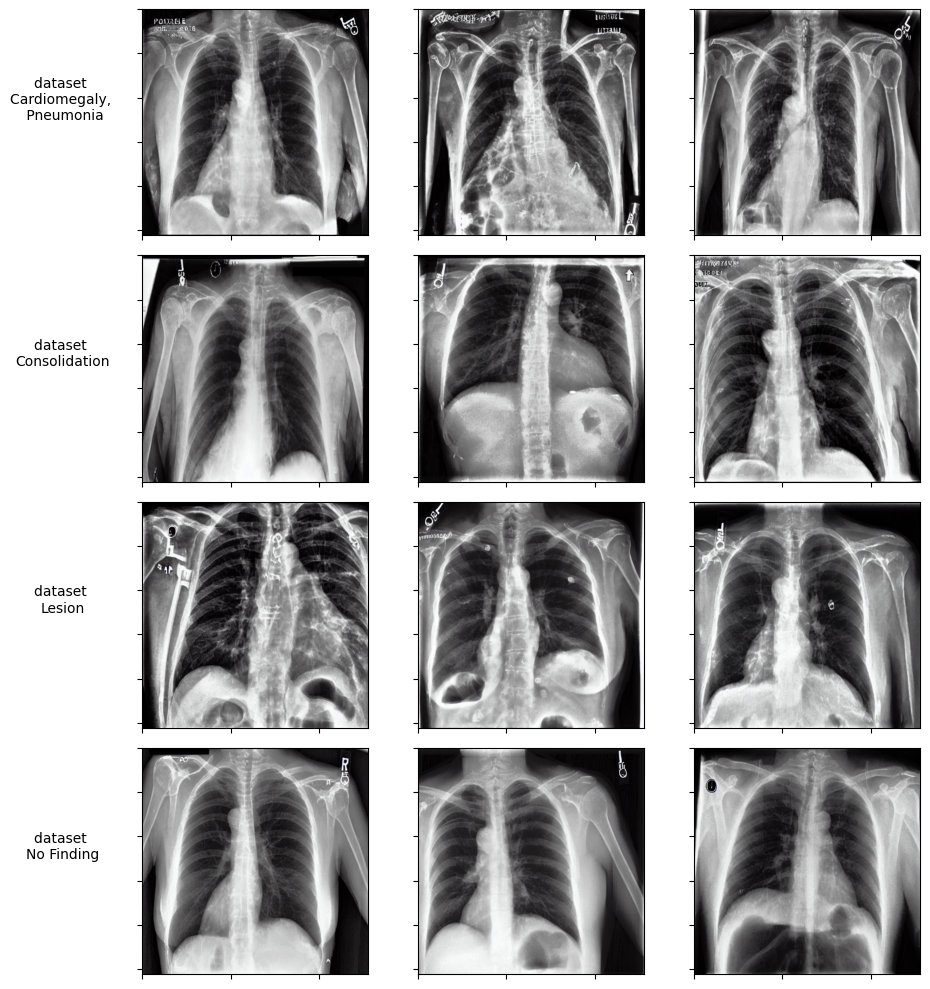

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:16<00:00,  2.99it/s]


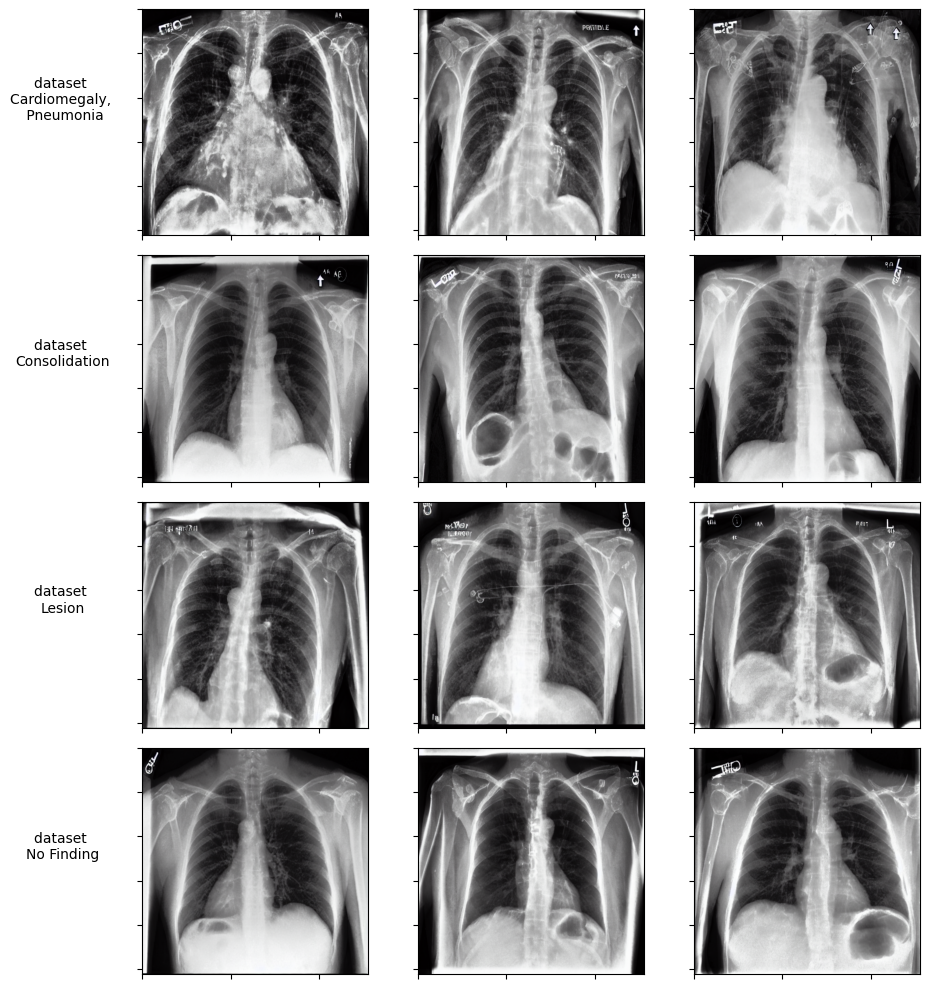

Keyword arguments {'dtype': torch.bfloat16} are not expected by StableDiffusionPipeline and will be ignored.
100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:13<00:00,  3.67it/s]


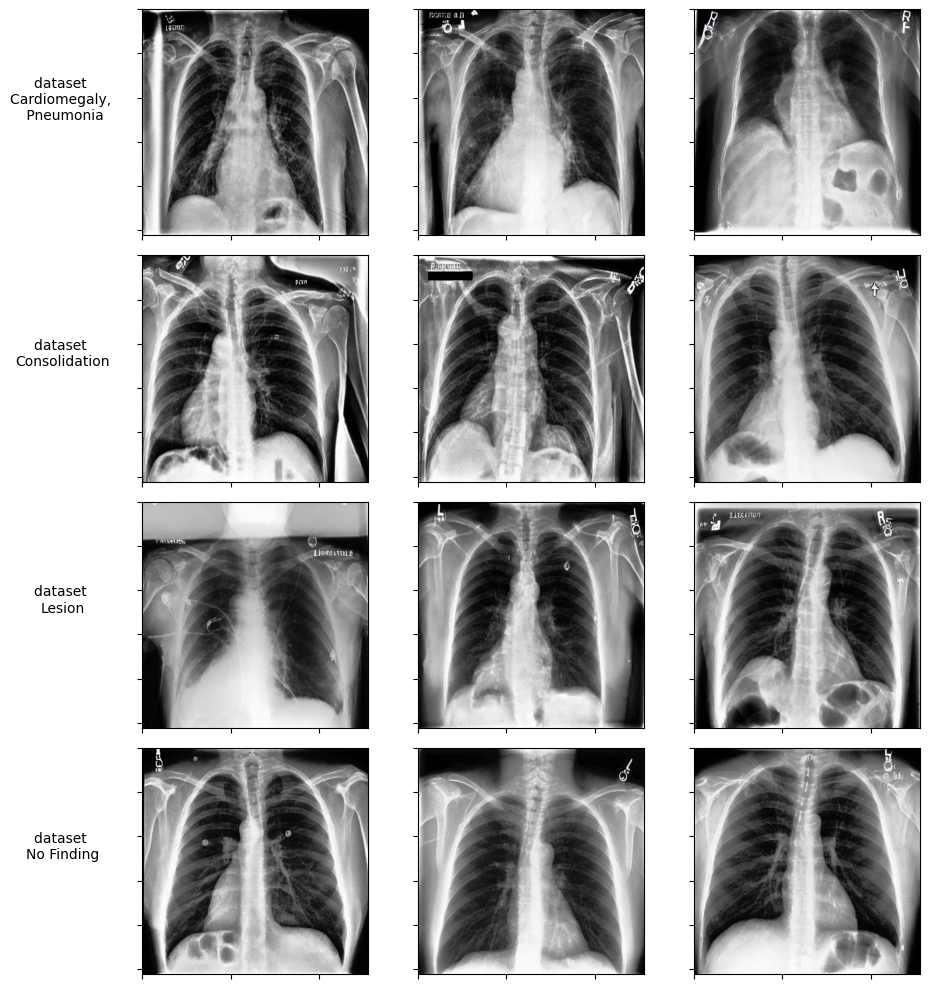

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:16<00:00,  2.96it/s]


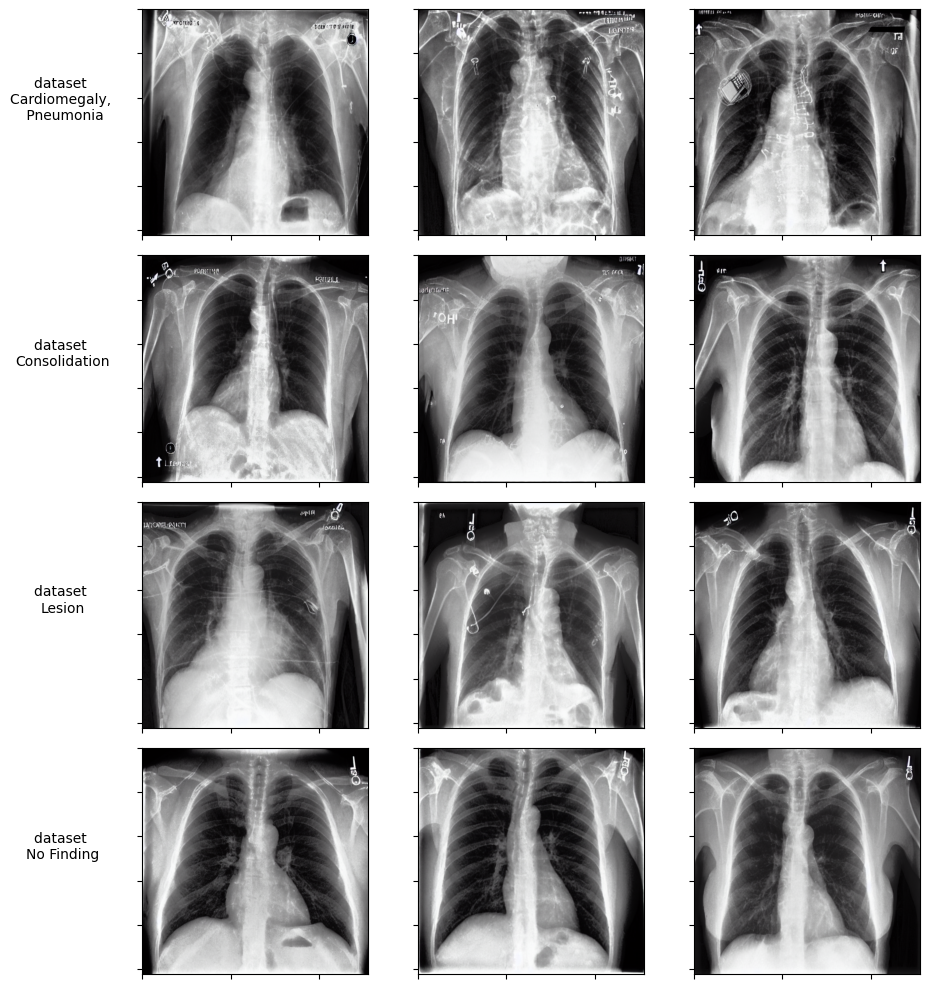

Keyword arguments {'dtype': torch.bfloat16} are not expected by StableDiffusionPipeline and will be ignored.
100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:11<00:00,  4.50it/s]


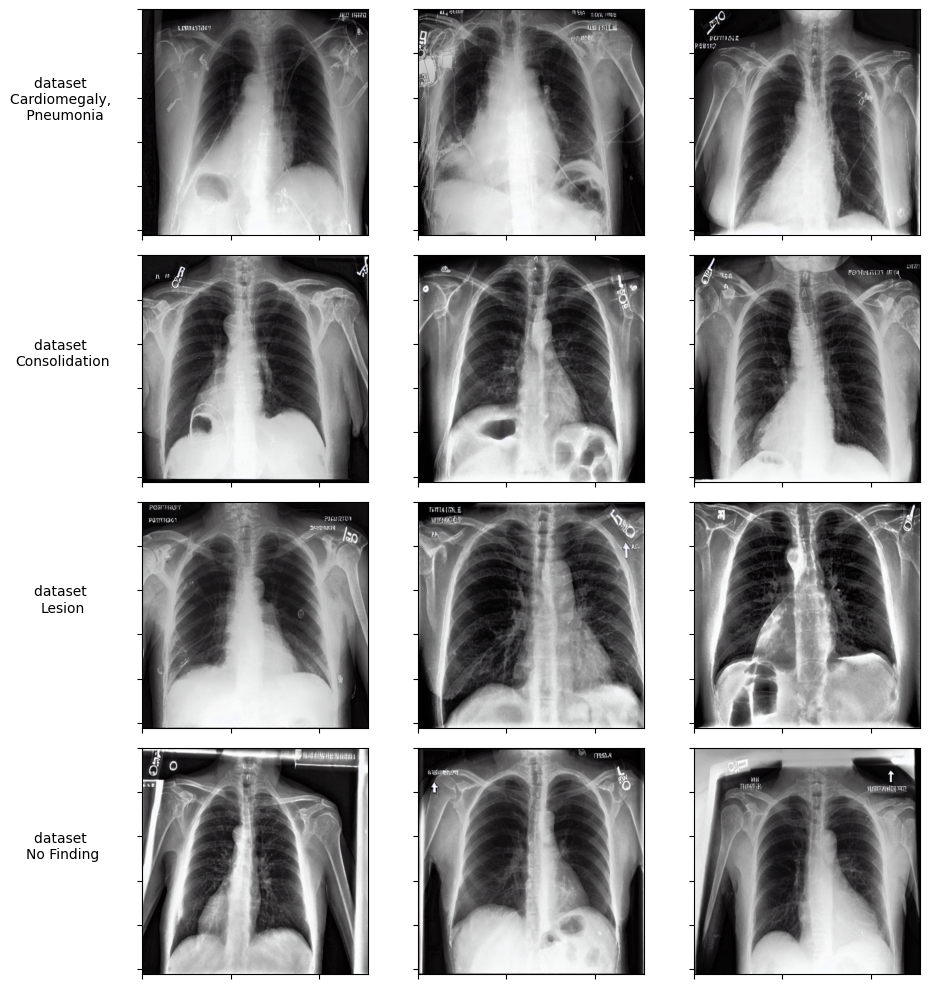

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:11<00:00,  4.48it/s]


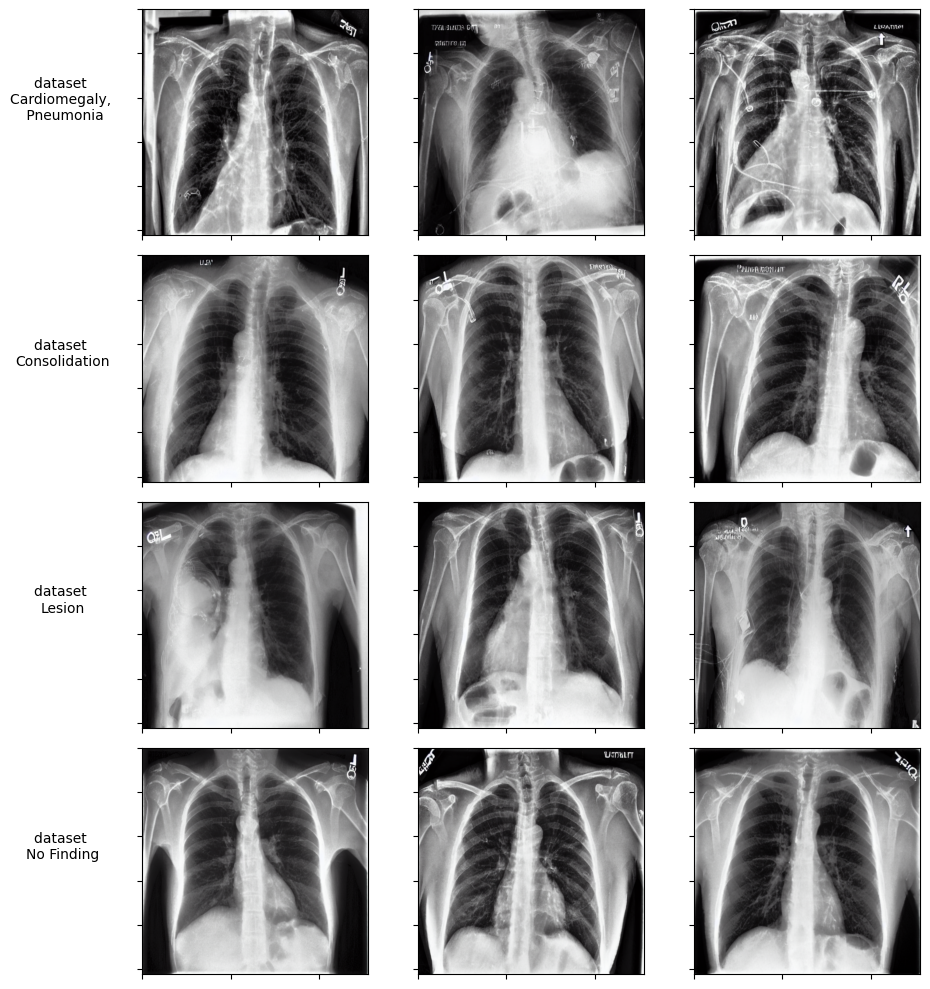

Keyword arguments {'dtype': torch.bfloat16} are not expected by StableDiffusionPipeline and will be ignored.
100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:11<00:00,  4.43it/s]


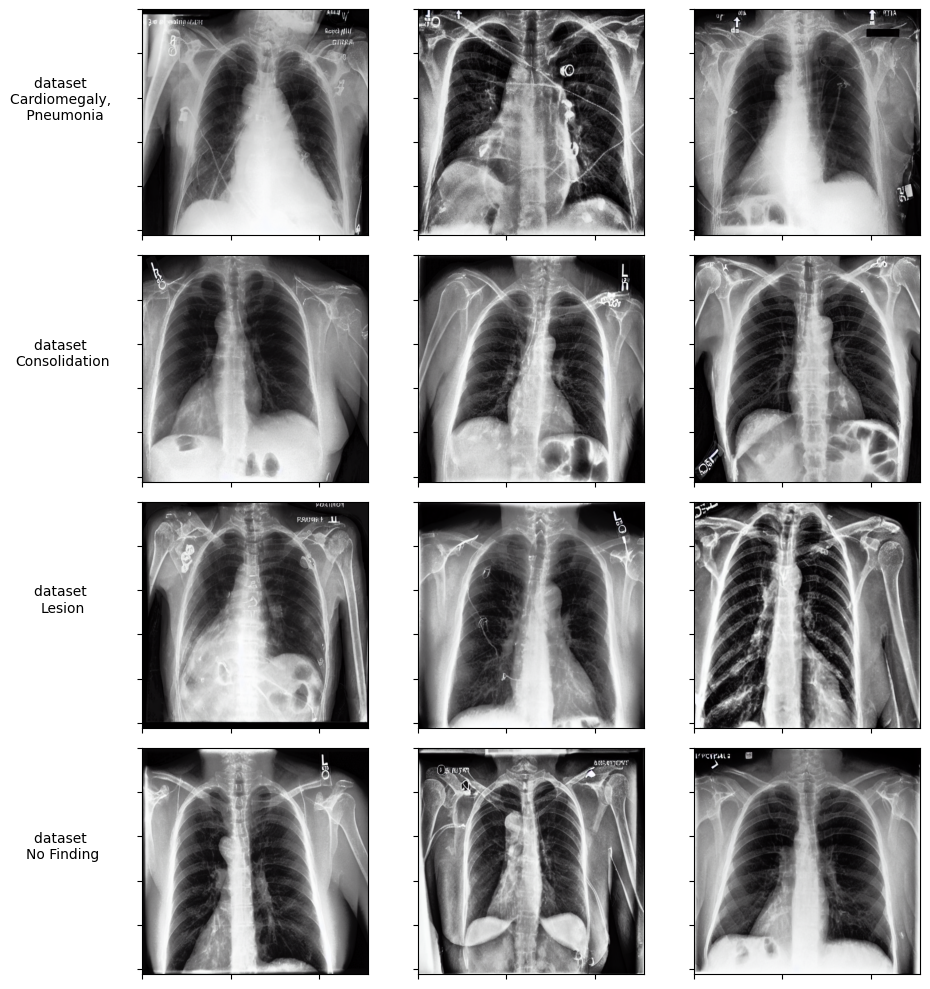

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:11<00:00,  4.52it/s]


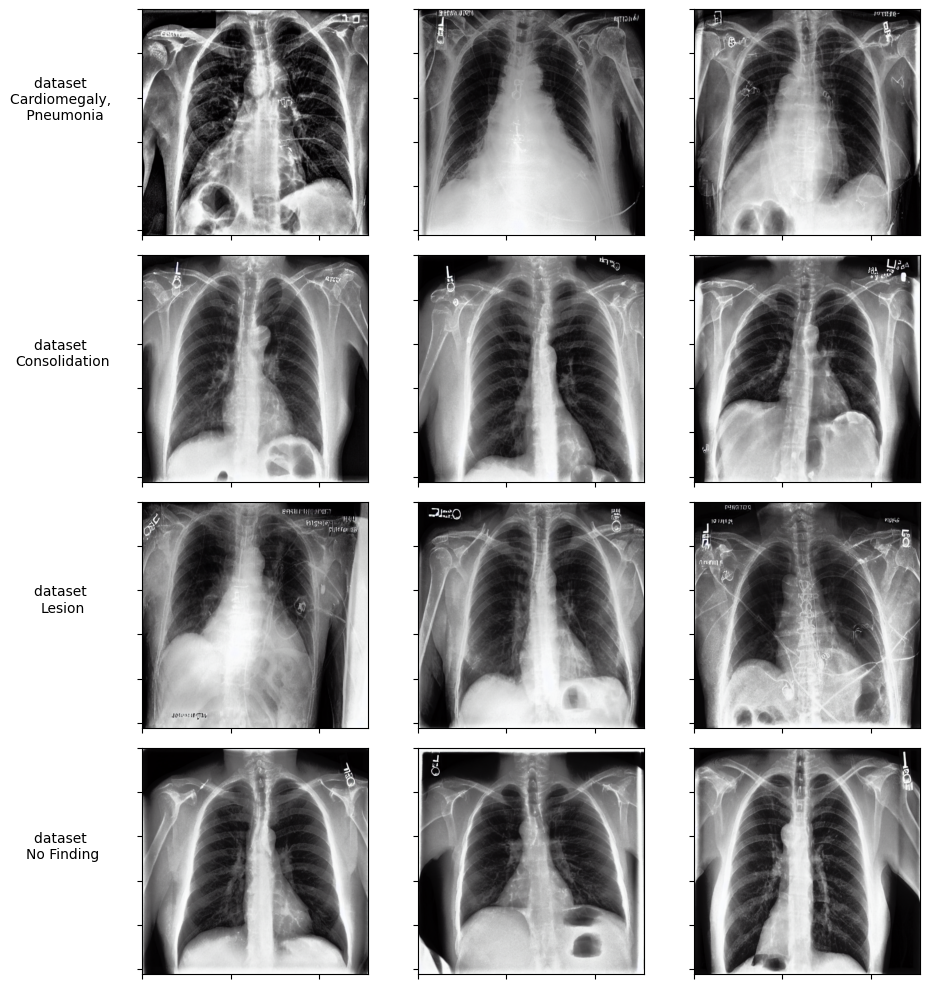

OSError: We couldn't connect to 'https://huggingface.co' to load this model, couldn't find it in the cached files and it looks like /mnt/scratch-lids/scratch/qixuanj/cxr_transfer_sd_mimic_chexpert_10_balanced/checkpoint-200/unet is not the path to a directory containing a config.json file.
Checkout your internet connection or see how to run the library in offline mode at 'https://huggingface.co/docs/diffusers/installation#offline-mode'.

In [10]:
keywords = [
            # "cxr_transfer_sd_mimic_chexpert_1000_match", 
            # "cxr_transfer_sd_mimic_chexpert_100_match", 
            "cxr_transfer_sd_mimic_chexpert_10_match", 
            "cxr_transfer_sd_mimic_chexpert_500_balanced",  
            "cxr_transfer_sd_mimic_chexpert_50_match", 
            "cxr_transfer_sd_mimic_nih_1000_balanced", 
            "cxr_transfer_sd_mimic_nih_1000_match", 
            "cxr_transfer_sd_mimic_padchest_1000_balanced", 
            "cxr_transfer_sd_mimic_padchest_1000_match",]
model_id = "runwayml/stable-diffusion-v1-5"
checkpoints = np.arange(200, 1001, 200)

for keyword in keywords: 
    print(keyword)
    for checkpoint in checkpoints: 
        file_prefix = f"/mnt/scratch-lids/scratch/qixuanj/{keyword}/checkpoint-{checkpoint}"
        fig_dir = f"/mnt/scratch-lids/scratch/qixuanj/{keyword}/figs"
        if not os.path.exists(fig_dir): 
            os.makedirs(fig_dir)
        unet = UNet2DConditionModel.from_pretrained(f"{file_prefix}/unet")
        
        pipe = DiffusionPipeline.from_pretrained(model_id, unet=unet, dtype=torch.bfloat16)
        pipe.to("cuda")
        
        num_images = 3
        prompts = [
            "Cardiomegaly, Pneumonia", 
            "Consolidation", 
            "Lesion",
            "No Finding",
        ]
        
        fig, ax = plt.subplots(len(prompts), num_images, figsize=(10,10))
        for i, p in enumerate(prompts): 
            prompt = f"a radiograph from dataset mimic with conditions {p}"
            images = pipe(prompt=prompt, 
                          strength=0.9, guidance_scale=7.5, num_inference_steps=50, 
                          num_images_per_prompt=num_images).images
            for j, img in enumerate(images): 
                ax[i, j].imshow(img)
                ax[i, j].set_xticklabels([])
                ax[i, j].set_yticklabels([])
            if p == "Cardiomegaly, Pneumonia": 
                p = "Cardiomegaly, \n Pneumonia"
            ax[i, 0].set_ylabel("dataset \n{}".format(p), rotation=0, labelpad=50)
        fig.tight_layout()
        plt.savefig(fig_dir + f"/mimic_checkpoint{checkpoint}.png", dpi=300)
        plt.show()
    
        transfer_dataset = keyword.split("_")[-3]
        fig, ax = plt.subplots(len(prompts), num_images, figsize=(10,10))
        for i, p in enumerate(prompts): 
            prompt = f"a radiograph from dataset {transfer_dataset} with conditions {p}"
            images = pipe(prompt=prompt, 
                          strength=0.9, guidance_scale=7.5, num_inference_steps=50, 
                          num_images_per_prompt=num_images).images
            for j, img in enumerate(images): 
                ax[i, j].imshow(img)
                ax[i, j].set_xticklabels([])
                ax[i, j].set_yticklabels([])
            if p == "Cardiomegaly, Pneumonia": 
                p = "Cardiomegaly, \n Pneumonia"
            ax[i, 0].set_ylabel("dataset \n{}".format(p), rotation=0, labelpad=50)
        fig.tight_layout()
        plt.savefig(fig_dir + f"/{transfer_dataset}_checkpoint{checkpoint}.png", dpi=300)
        plt.show()

## Original dataset for reference

In [31]:
# Sanity check with dataset 
from datasets import load_dataset

In [32]:
ds = load_dataset("/data/healthy-ml/scratch/qixuanj/generative_validation/sd_chestxray_loading.py")

/data/healthy-ml/scratch/qixuanj/anaconda3/envs/control/lib/python3.8/site-packages/datasets/load.py:929: FutureWarning: The repository for sd_chestxray_loading contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at /data/healthy-ml/scratch/qixuanj/generative_validation/sd_chestxray_loading.py
You can avoid this message in future by passing the argument `trust_remote_code=True`.
Passing `trust_remote_code=True` will be mandatory to load this dataset from the next major release of `datasets`.
  warnings.warn(
Repo card metadata block was not found. Setting CardData to empty.


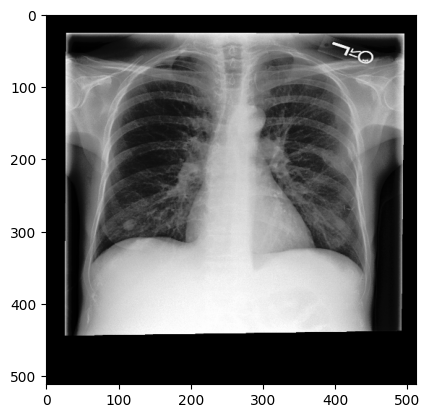

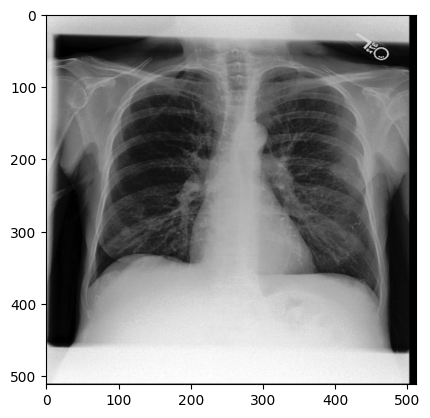

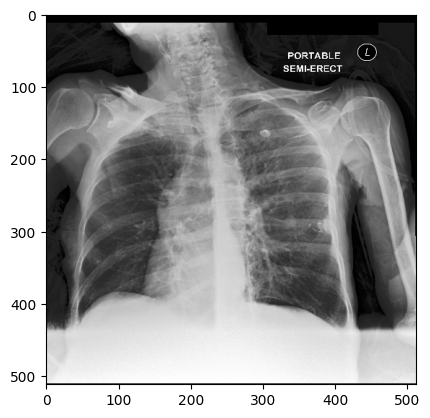

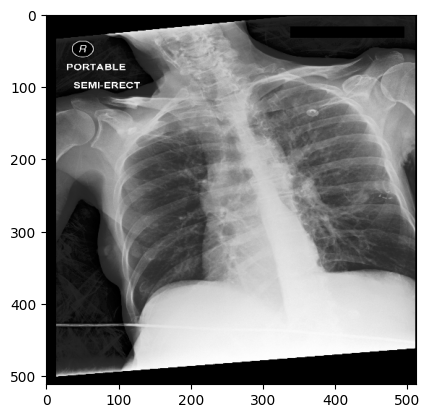

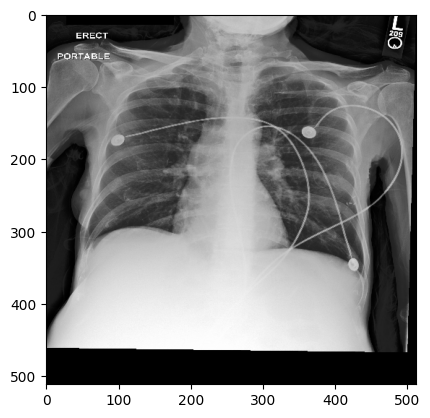

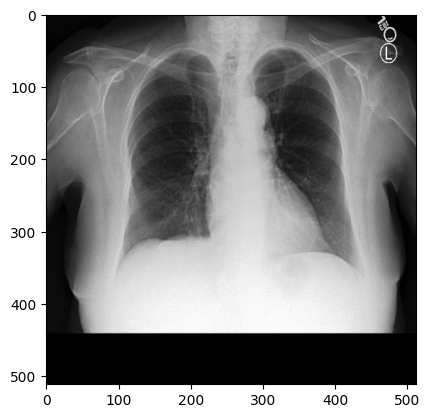

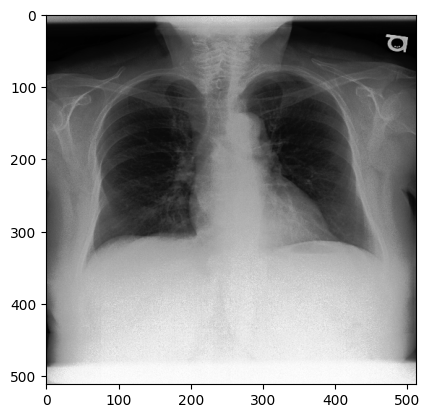

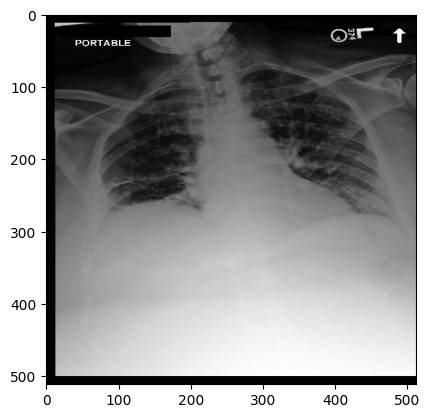

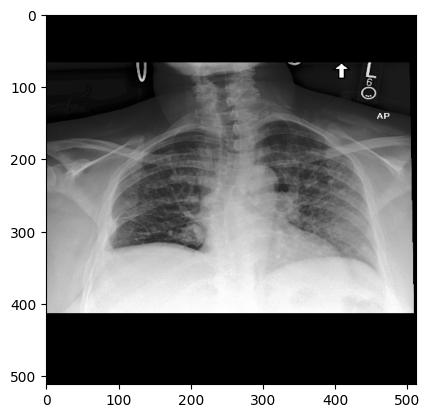

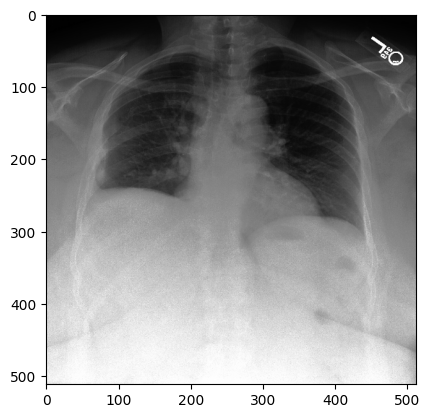

In [47]:
for i in range(10): 
    if "mimic" in ds['train'][i]['prompt']: 
        plt.imshow(ds['train'][i]['img'])
        plt.show()

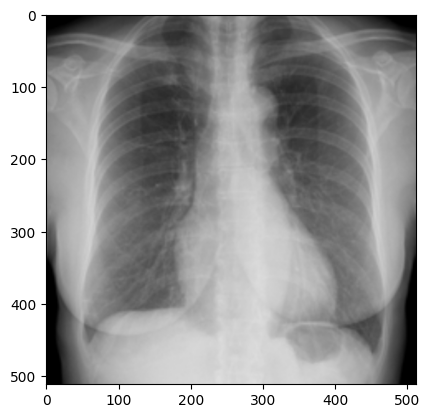

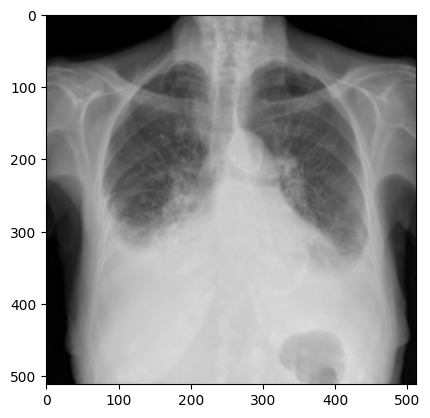

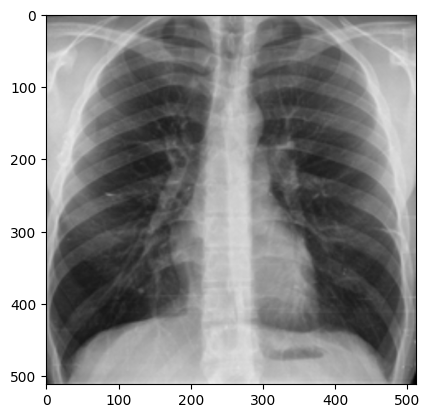

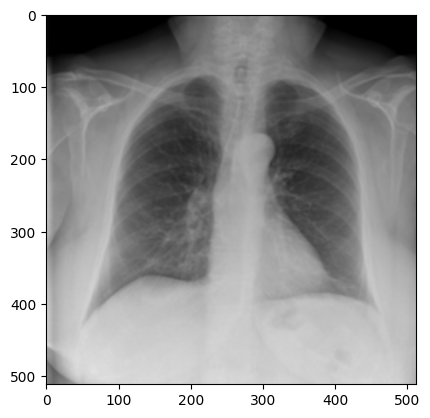

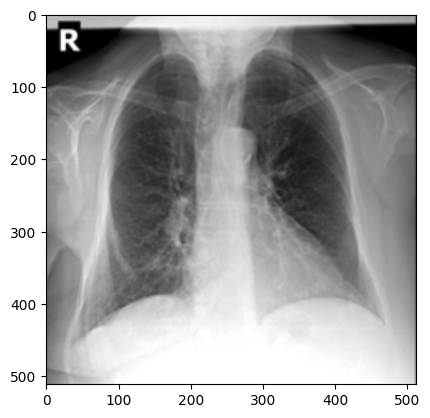

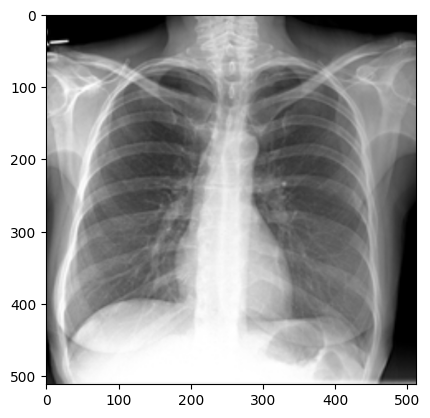

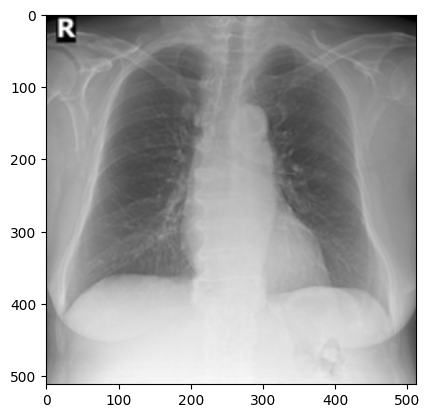

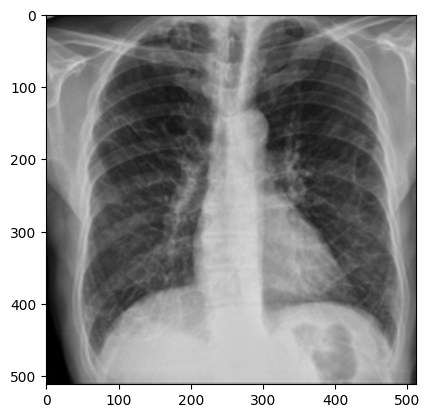

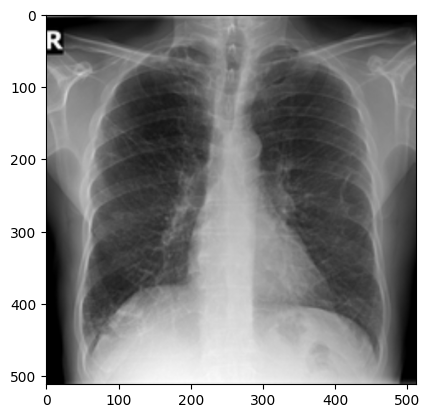

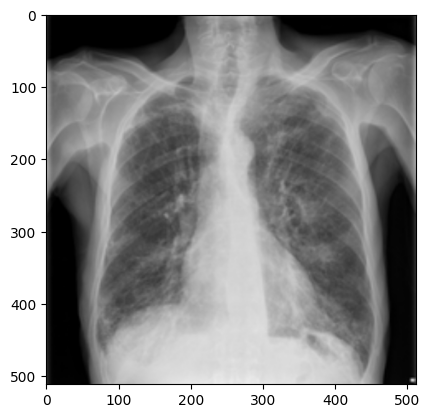

In [50]:
offset = 170509
for i in range(offset, offset + 10): 
    if "padchest" in ds['train'][i]['prompt']: 
        plt.imshow(ds['train'][i]['img'])
        plt.show()

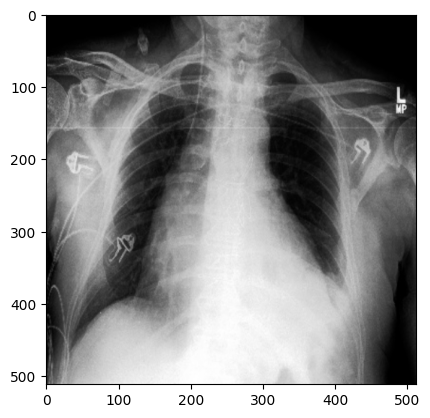

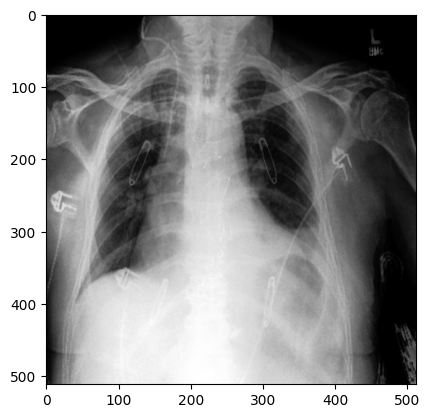

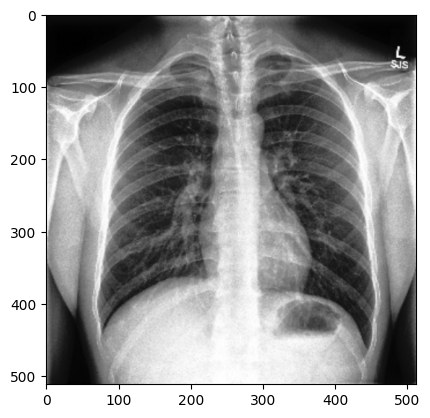

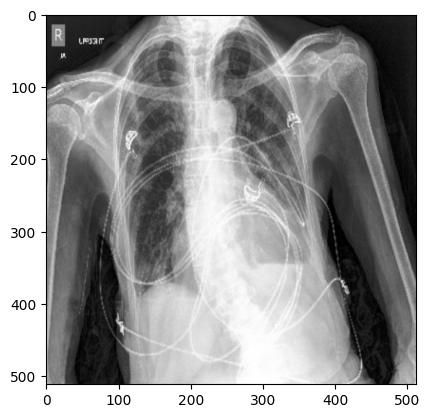

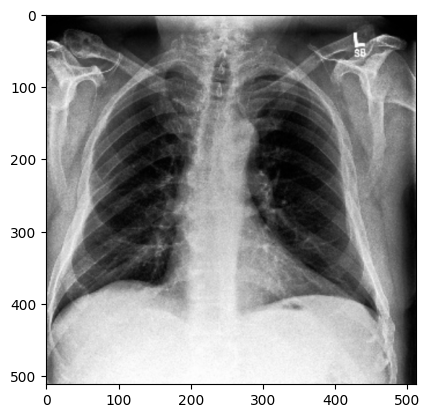

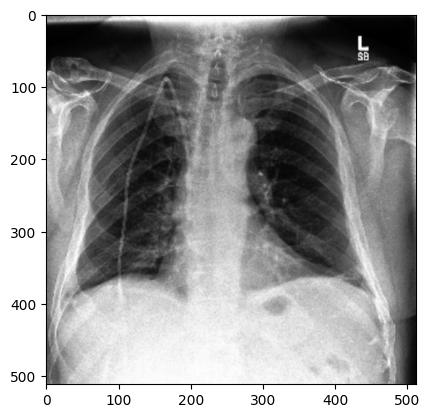

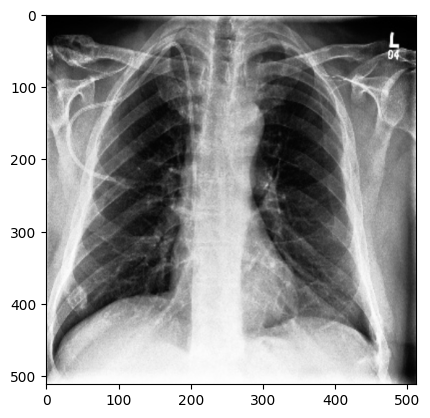

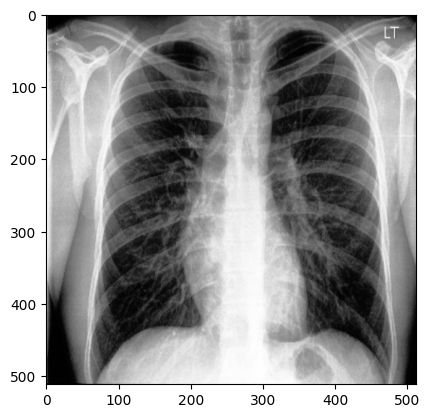

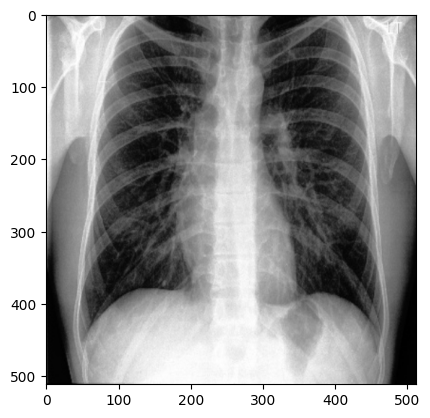

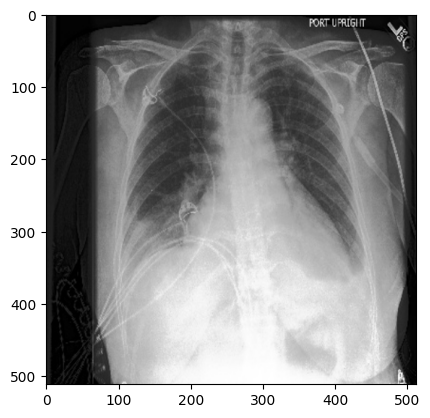

In [52]:
offset = 170509 + 66330
for i in range(offset, offset + 10): 
    if "chexpert" in ds['train'][i]['prompt']: 
        plt.imshow(ds['train'][i]['img'])
        plt.show()

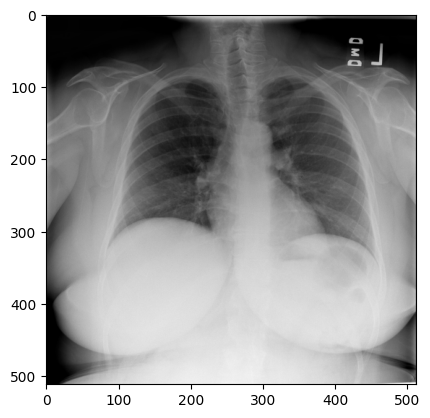

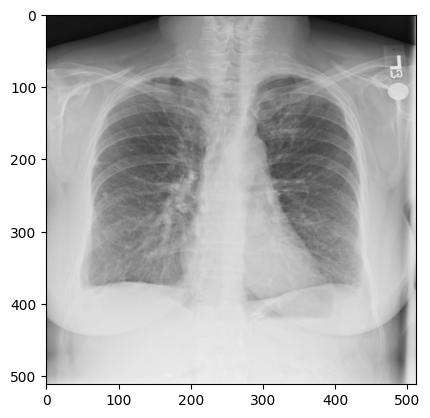

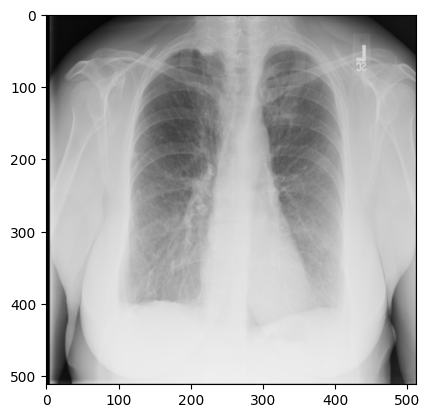

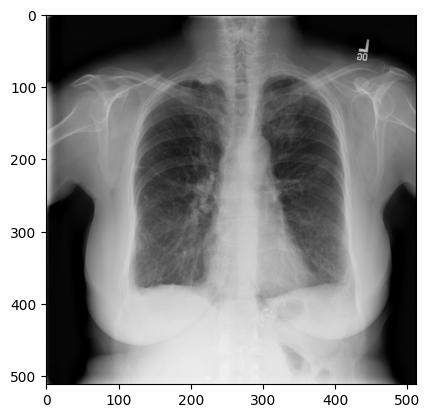

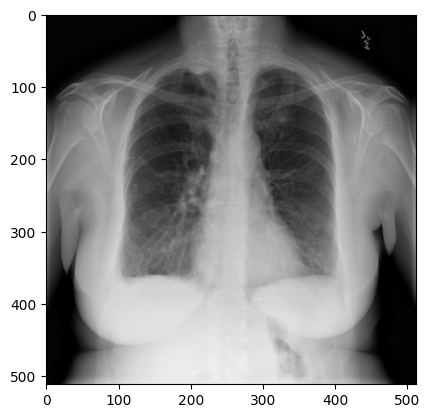

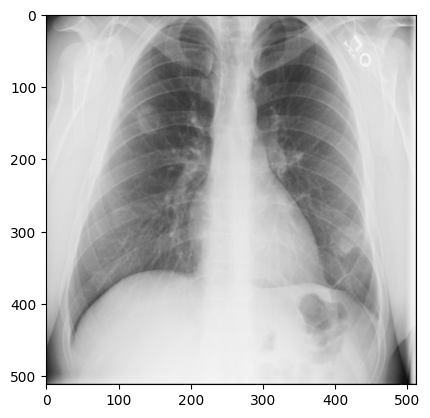

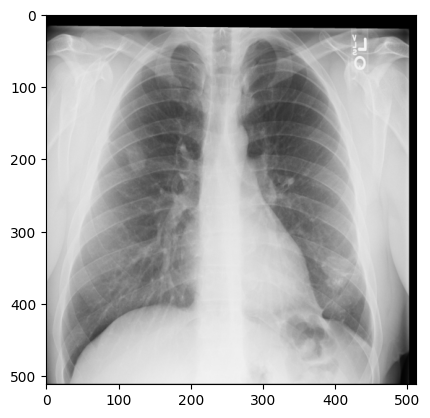

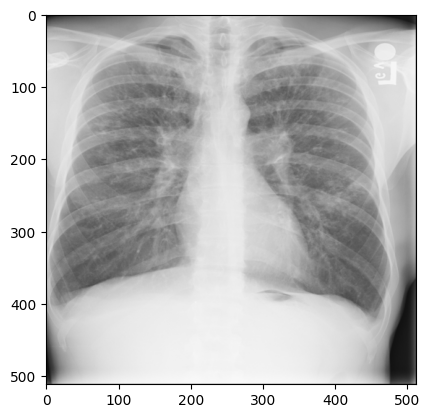

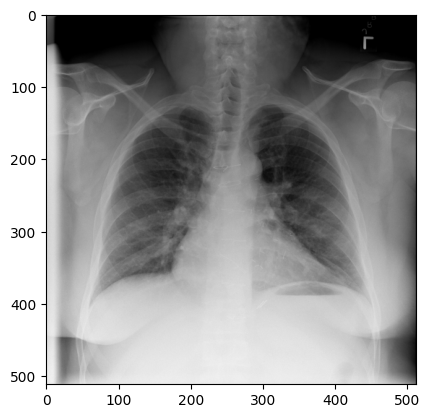

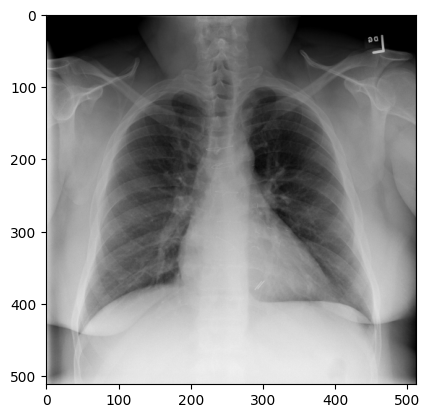

In [55]:
offset = 170509 + 66330 + 134585 
for i in range(offset, offset + 10): 
    if "nih" in ds['train'][i]['prompt']: 
        plt.imshow(ds['train'][i]['img'])
        plt.show()